## Panorama Stitching using SuperGlue
SuperGlue network is a Graph Neural Network combined with an Optimal Matching layer that is trained to perform matching on two sets of sparse image features.

***Source Images from Open Adobe Project***
[Adobe Panoramas](https://liquidtelecom.dl.sourceforge.net/project/adobedatasets.adobe/adobe_panoramas.tgz)

In [5]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import os
import re
%config IPCompleter.greedy=True
%config Completer.use_jedi = False

In [6]:
# generating the necessary txt file to input for the super glue algorithm
img_name = 'BE_1744229291' # set of outdoor images
num_images = 18
image_folder = "../Panorama/BE/Session_1744229291/"
output_file = "BE_1744229291.txt"
npz_dir = "../Panorama/BE/Session_1744229291/outputSG"

pattern = re.compile(r"image_(\d+)\.png")
files = []

for fname in os.listdir(image_folder):
    match = pattern.match(fname)
    if match:
        index = int(match.group(1))
        files.append((index, fname)) #file index, folder name pair

files.sort(reverse=True)

# Order of the images. To stitch left and right images as depicted in the below
with open(output_file, 'w') as f:
    for i in range(len(files) - 1):
        f.write(f"{files[i][1]} {files[i+1][1]}\n")

In [ ]:
# Running the super glue algorithm on outdoor dataset to match features
"""
    Do not resize the images, 
    If you need to use the extracted keypoints,
    to process the "original" source images.

    Set the parameter to -1 to avoid resizing
    --resize -1
    
    Other parameter can be set as folows,
    to extract the best matching features.
    * Non maximum Suppression Radius = 5
    * Matching Confidence = 0.9
"""
!python match_pairs.py  --resize -1\
                        --superglue outdoor \
                        --max_keypoints 2048 \
                        --nms_radius 5 \
                        --resize_float \
                        --input_dir ../Panorama/BE/Session_1744229291/ \
                        --input_pairs BE_1744229291.txt \
                        --output_dir ../Panorama/BE/Session_1744229291/outputSG/ \
                        --viz \
                        --keypoint_threshold 0.05 \
                        --match_threshold 0.9

Namespace(cache=False, eval=False, fast_viz=False, force_cpu=False, input_dir='../Panorama/BE/Session_1744229291/', input_pairs='BE_1744229291.txt', keypoint_threshold=0.05, match_threshold=0.9, max_keypoints=2048, max_length=-1, nms_radius=5, opencv_display=False, output_dir='../Panorama/BE/Session_1744229291/outputSG/', resize=[-1], resize_float=True, show_keypoints=False, shuffle=False, sinkhorn_iterations=20, superglue='outdoor', viz=True, viz_extension='png')
Will not resize images
Running inference on device "cuda"
Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)
Looking for data in directory "../Panorama/BE/Session_1744229291"
Will write matches to directory "../Panorama/BE/Session_1744229291/outputSG"
Will write visualization images to directory "../Panorama/BE/Session_1744229291/outputSG"
[Finished pair     0 of    17] load_image=0.112 matcher=0.537 viz_match=0.713 total=1.362 sec {0.7 FPS} 
[Finished pair     1 of    17] load_image=0.111 matcher=0.471 viz_ma

In [8]:
#generatig the npz files for extract matching information
npz_files = [f"{files[i][1].replace('.png', '')}_{files[i+1][1].replace('.png', '')}_matches.npz" for i in range(len(files)-1)]

for npz_file in npz_files:
    path = os.path.join(npz_dir, npz_file)
    try:
        data = np.load(path)
        print(f"{npz_file} contains keys: {data.files}")
    except FileNotFoundError:
        print(f"File not found {path}")


image_0031858_image_0031857_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031857_image_0031856_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031856_image_0031855_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031855_image_0031853_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031853_image_0031852_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031852_image_0031851_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031851_image_0031849_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031849_image_0031848_matches.npz contains keys: ['keypoints0', 'keypoints1', 'matches', 'match_confidence']
image_0031848_image_0031846_matches.npz contains keys: ['keypoints0', 'keypoints

For each keypoint in `keypoints0`, the `matches` array indicates the index of the matching keypoint in `keypoints1`, or `-1` if the keypoint is unmatched.

In [9]:
# extracting information from the npz files 
def loadNPZ(npz_file):    
    npz = np.load("../Panorama/BE/Session_1744229291/outputSG/" + npz_file)
    point_set1 = npz['keypoints0'][npz['matches']>-1]
    matching_indexes =  npz['matches'][npz['matches']>-1] # -1 if the keypoint is unmatched
    point_set2 = npz['keypoints1'][matching_indexes]
    print("Number of matching points for the findHomography algorithm:")
    print("In left  image:", len(point_set1),"\nIn right image:", len(point_set2))
    return point_set1, point_set2

In [10]:
def pltSourceImages(img_left_path, img_right_path, point_set1, point_set2):
    im_left = cv.imread(img_left_path, cv.IMREAD_ANYCOLOR)
    im_right = cv.imread(img_right_path, cv.IMREAD_ANYCOLOR)

    for point in point_set1.astype(np.int32):
        cv.circle(im_left, tuple(point), radius=8, color=(255, 255, 0), thickness=-1)
    for point in point_set2.astype(np.int32):
        cv.circle(im_right, tuple(point), radius=8, color=(255, 255, 0), thickness=-1)

    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.imshow(im_left[..., ::-1]), plt.title("Left Image")
    plt.subplot(122), plt.imshow(im_right[..., ::-1]), plt.title("Right Image")
    plt.show()



In [11]:
def plotMatches(match_img_path):
    img = cv.imread(match_img_path, cv.IMREAD_ANYCOLOR)
    if img is None:
        print(f"Could not load {match_img_path}")
        return
    plt.figure(figsize=(10, 10))
    plt.imshow(img[..., ::-1])
    plt.title("Matched Points")
    plt.show()


In [18]:
# === CONFIGURATION ===
input_image_dir = "../Panorama/BE/Session_1744229291/"
output_dir = "../Panorama/BE/Session_1744229291/outputSG/"

# === STEP 1: Get sorted list of input images ===
sorted_images = sorted(
    [f for f in os.listdir(input_image_dir) if f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === STEP 2: Loop through adjacent image pairs ===
for i in range(len(sorted_images) - 1):
    img_left = sorted_images[i]
    img_right = sorted_images[i + 1]

    base_left = img_left.replace(".png", "")
    base_right = img_right.replace(".png", "")

    # === STEP 3: Build filenames ===
    npz_file = f"{base_left}_{base_right}_matches.npz"
    match_img = f"{base_left}_{base_right}_matches.png"
    npz_path = os.path.join(output_dir, npz_file)
    match_img_path = os.path.join(output_dir, match_img)
    img_left_path = os.path.join(input_image_dir, img_left)
    img_right_path = os.path.join(input_image_dir, img_right)

    print(f"\n🔍 Processing pair: {img_left} ↔ {img_right}")

    # === Load matching keypoints ===
    try:
        point_set1, point_set2 = loadNPZ(npz_path)
    except FileNotFoundError:
        print(f"❌ Missing .npz file: {npz_path}")
        continue

    # === Visualize feature locations ===
    pltSourceImages(img_left_path, img_right_path, point_set1, point_set2)

    # === Show match overlay image ===
    plotMatches(match_img_path)

    # === Read source images ===
    im_left = cv.imread(img_left_path, cv.IMREAD_ANYCOLOR)
    im_right = cv.imread(img_right_path, cv.IMREAD_ANYCOLOR)

    # === Find Homography ===
    H, status = cv.findHomography(point_set1, point_set2, cv.RANSAC, 5.0)
    print("📐 Homography Matrix:\n", H)

    # === Warp and blend ===
    panorama = cv.warpPerspective(im_right, np.linalg.inv(H), (1500, 800))
    panorama[0:im_left.shape[0], 0:im_left.shape[1]] = im_left

    # === Show result ===
    plt.figure(figsize=(10, 10))
    plt.imshow(panorama[..., ::-1])
    plt.title("Panorama")
    plt.show()

    print("-" * 100)


🔍 Processing pair: image_0031858.png ↔ image_0031857.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031858_image_0031857_matches.npz

🔍 Processing pair: image_0031857.png ↔ image_0031856.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031857_image_0031856_matches.npz

🔍 Processing pair: image_0031856.png ↔ image_0031855.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031856_image_0031855_matches.npz

🔍 Processing pair: image_0031855.png ↔ image_0031853.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031855_image_0031853_matches.npz

🔍 Processing pair: image_0031853.png ↔ image_0031852.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031853_image_0031852_matches.npz

🔍 Processing pair: image_0031852.png ↔ image_0031851.png
❌ Missing .npz file: ../Panorama/BE/Session_1744229291/outputSG/image_0031852_image_0031851_matches.npz

🔍 Processing pair: image_00

✅ Sorted input images: ['image_0031858.png', 'image_0031857.png', 'image_0031856.png', 'image_0031855.png', 'image_0031853.png', 'image_0031852.png', 'image_0031851.png', 'image_0031849.png', 'image_0031848.png', 'image_0031846.png', 'image_0031845.png', 'image_0031843.png', 'image_0031842.png', 'image_0031840.png', 'image_0031838.png', 'image_0031836.png', 'image_0031834.png', 'image_0031831.png']

🔍 Processing: image_0031858.png ↔ image_0031857.png
✅ Matched keypoints: 152


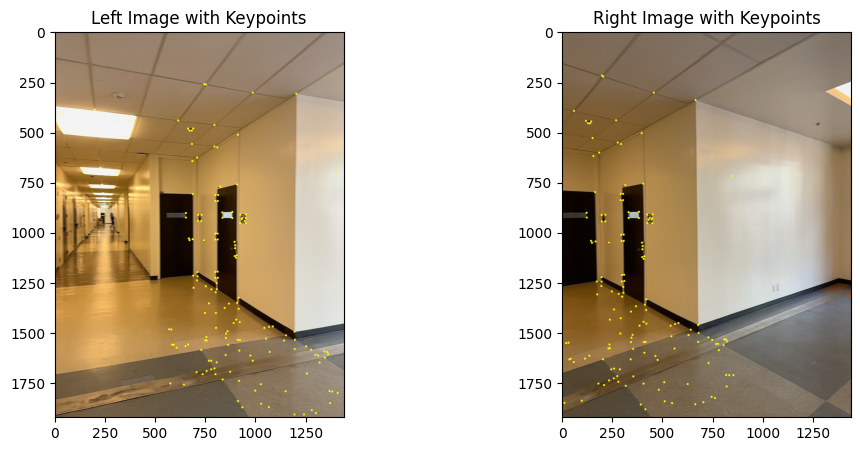

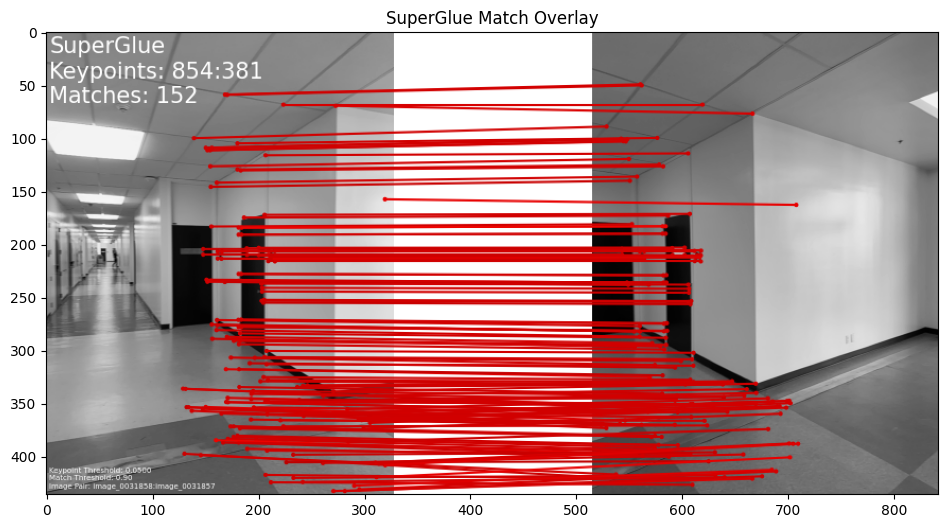

📐 Homography Matrix:
 [[ 1.42656521e+00 -5.71341912e-02 -7.03841160e+02]
 [ 2.90505203e-01  1.22652429e+00 -2.13211524e+02]
 [ 3.25541004e-04 -2.95174926e-05  1.00000000e+00]]


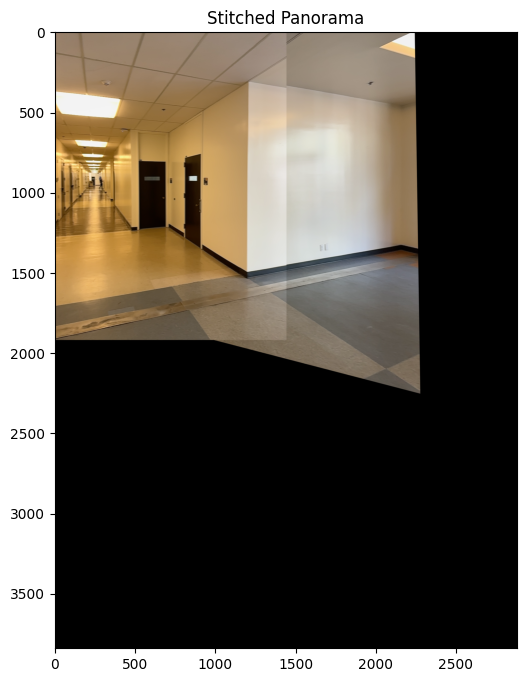

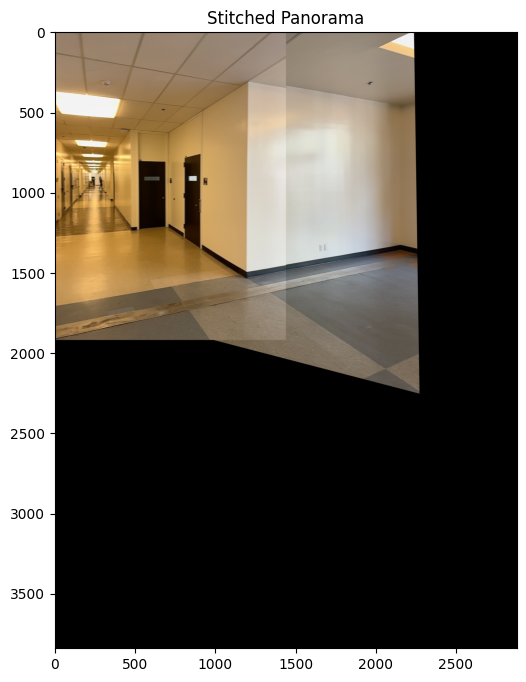

--------------------------------------------------------------------------------

🔍 Processing: image_0031857.png ↔ image_0031856.png
✅ Matched keypoints: 51


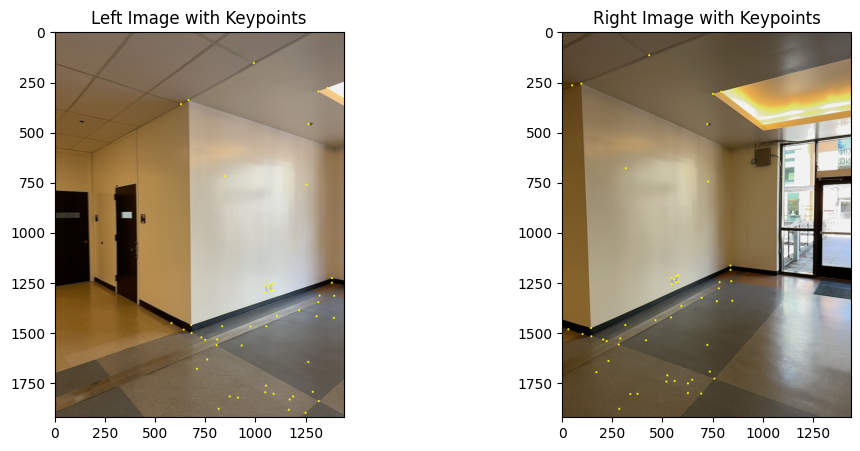

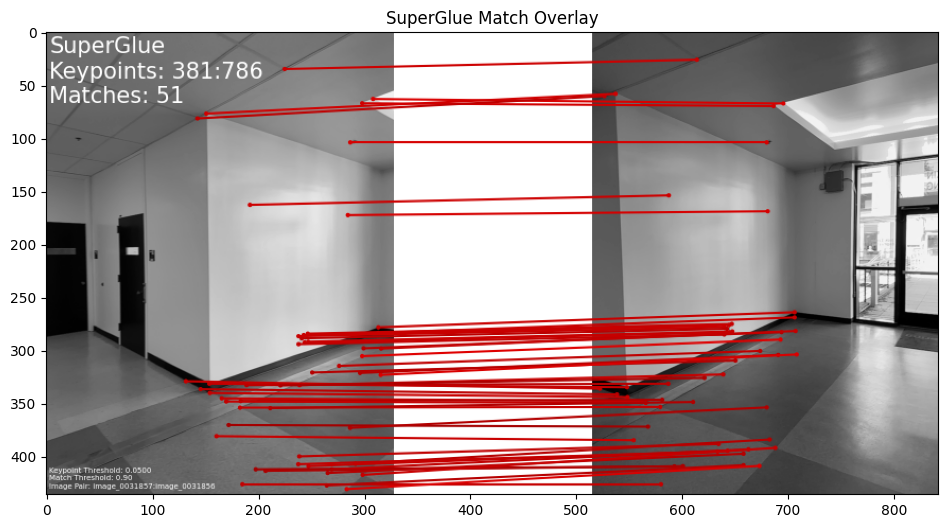

📐 Homography Matrix:
 [[ 1.49137893e+00 -4.19154083e-02 -7.65222425e+02]
 [ 2.32857730e-01  1.39404068e+00 -3.31770983e+02]
 [ 3.02327325e-04  3.90120914e-05  1.00000000e+00]]


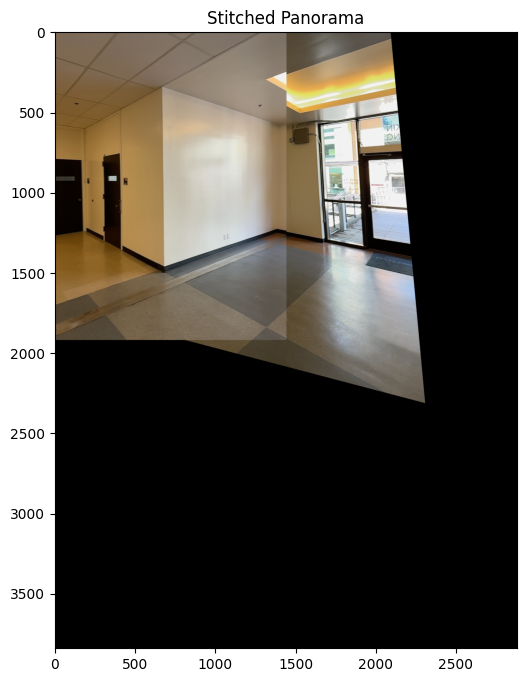

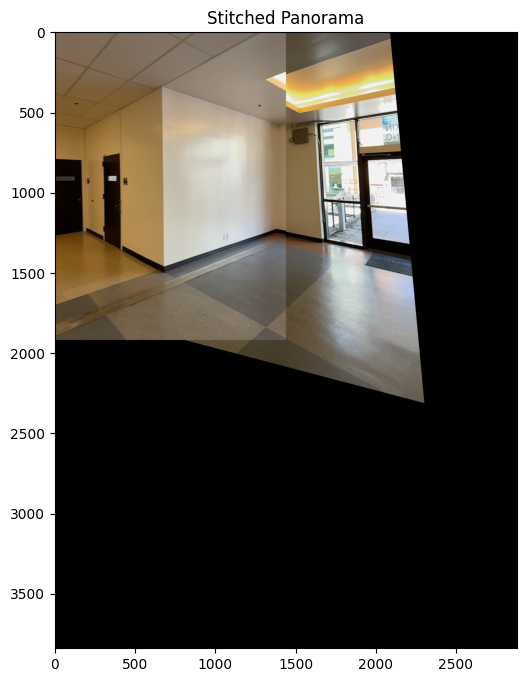

--------------------------------------------------------------------------------

🔍 Processing: image_0031856.png ↔ image_0031855.png
✅ Matched keypoints: 364


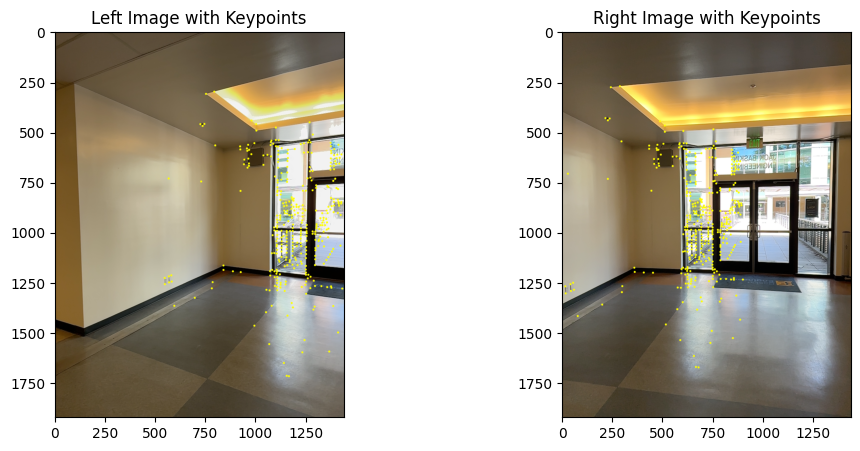

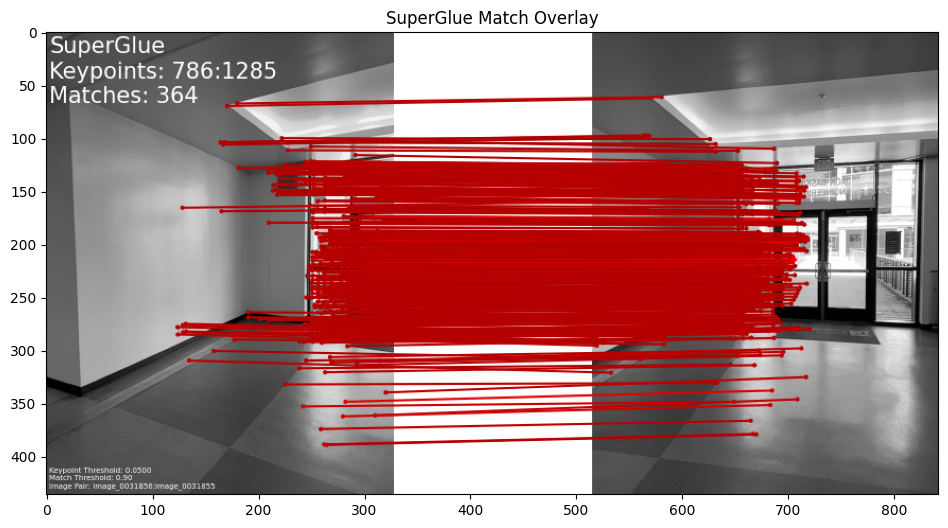

📐 Homography Matrix:
 [[ 1.63721432e+00  3.02785773e-02 -9.12359652e+02]
 [ 3.93574698e-01  1.43552816e+00 -3.86051015e+02]
 [ 4.31506130e-04  1.33490127e-05  1.00000000e+00]]


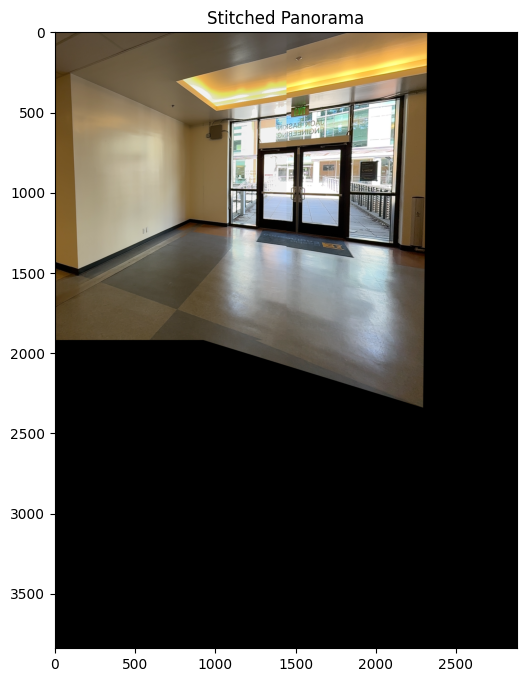

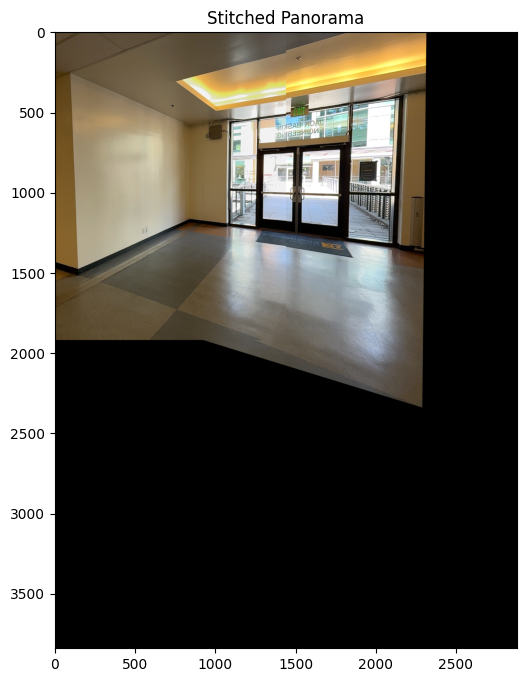

--------------------------------------------------------------------------------

🔍 Processing: image_0031855.png ↔ image_0031853.png
✅ Matched keypoints: 501


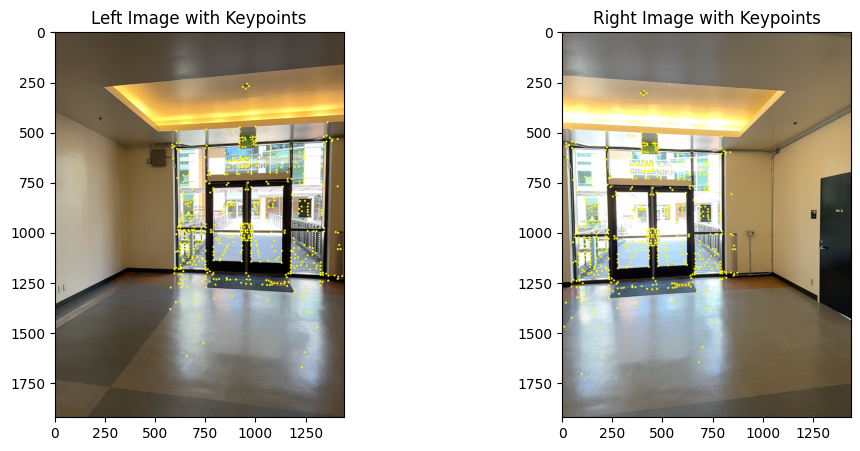

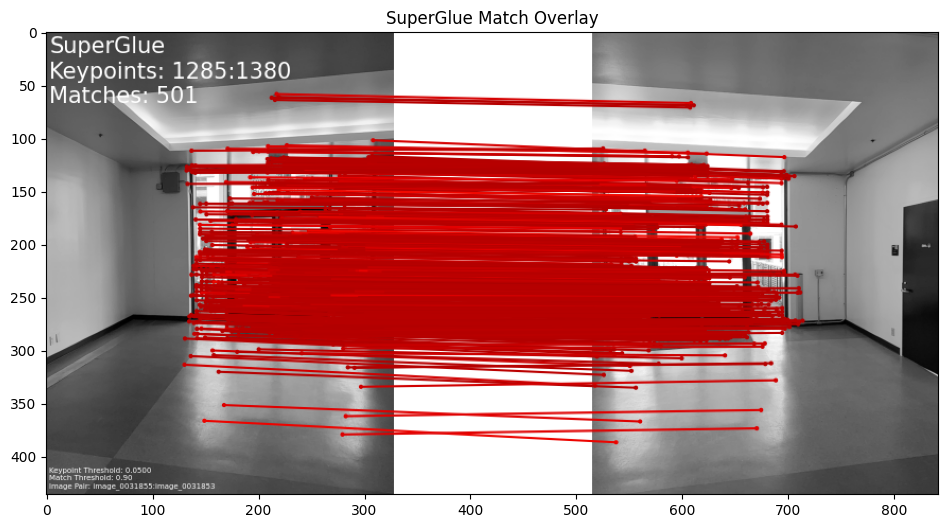

📐 Homography Matrix:
 [[ 1.56189602e+00  2.89575582e-02 -9.02389232e+02]
 [ 3.64022030e-01  1.35775814e+00 -2.96918344e+02]
 [ 4.07438292e-04 -1.54674717e-05  1.00000000e+00]]


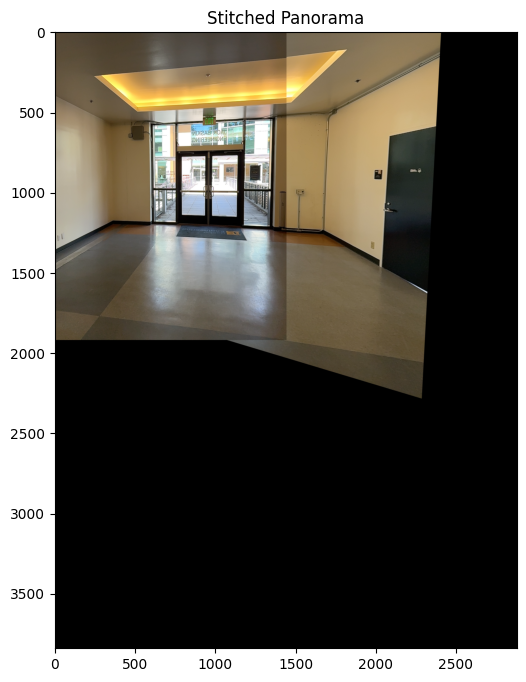

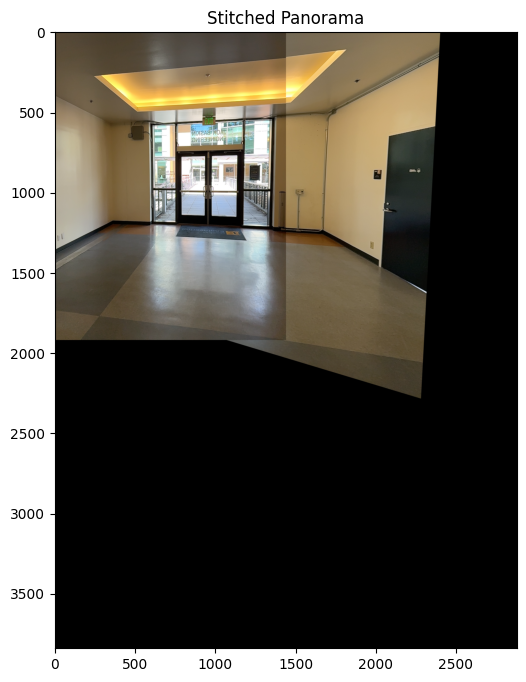

--------------------------------------------------------------------------------

🔍 Processing: image_0031853.png ↔ image_0031852.png
✅ Matched keypoints: 163


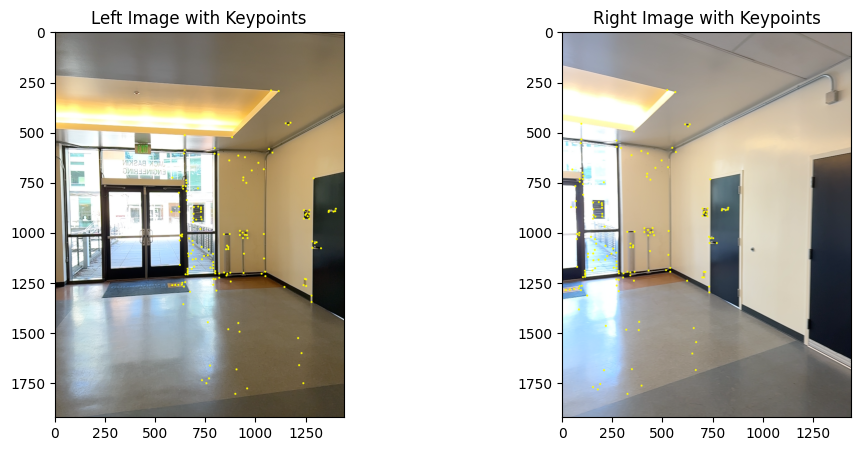

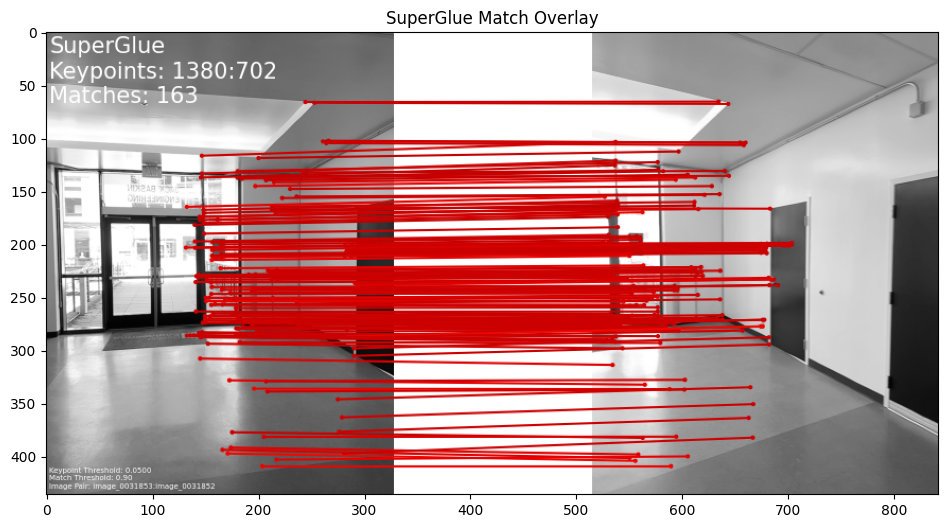

📐 Homography Matrix:
 [[ 1.67059035e+00  3.48915530e-02 -9.76533947e+02]
 [ 4.43698342e-01  1.51586037e+00 -4.81745404e+02]
 [ 4.71102933e-04  2.78626122e-05  1.00000000e+00]]


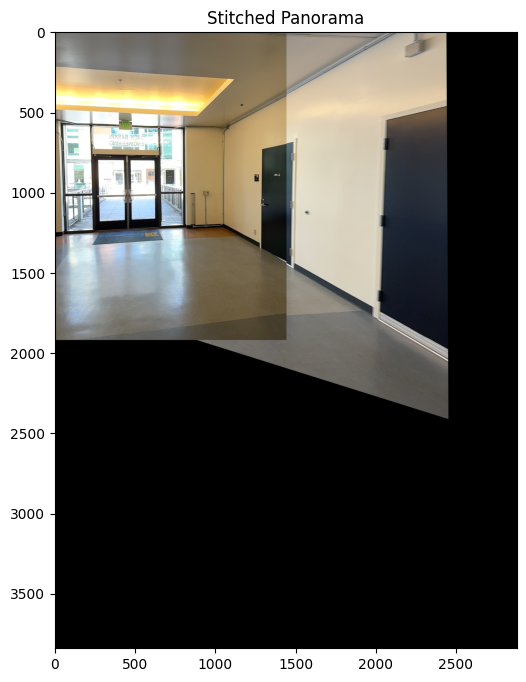

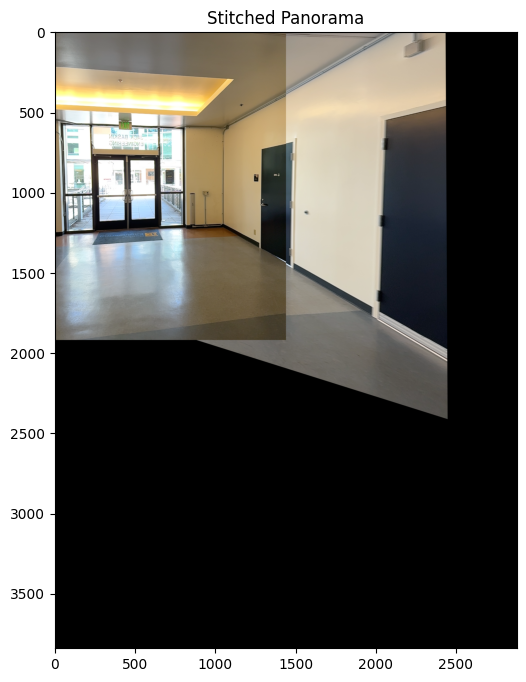

--------------------------------------------------------------------------------

🔍 Processing: image_0031852.png ↔ image_0031851.png
✅ Matched keypoints: 112


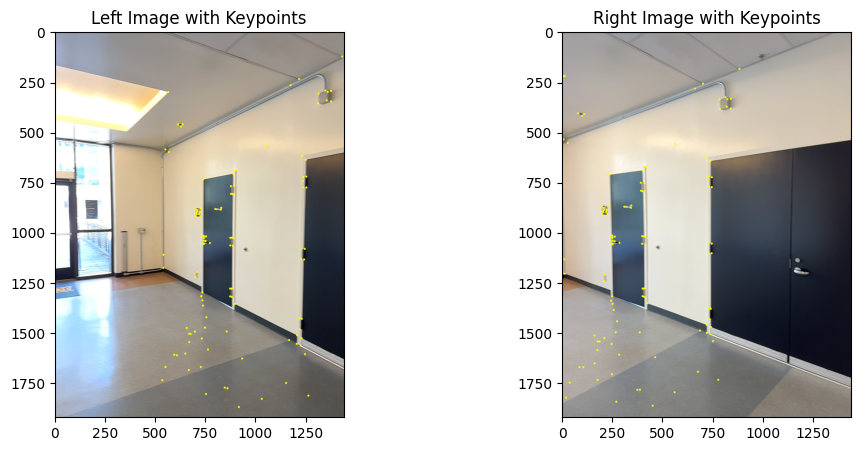

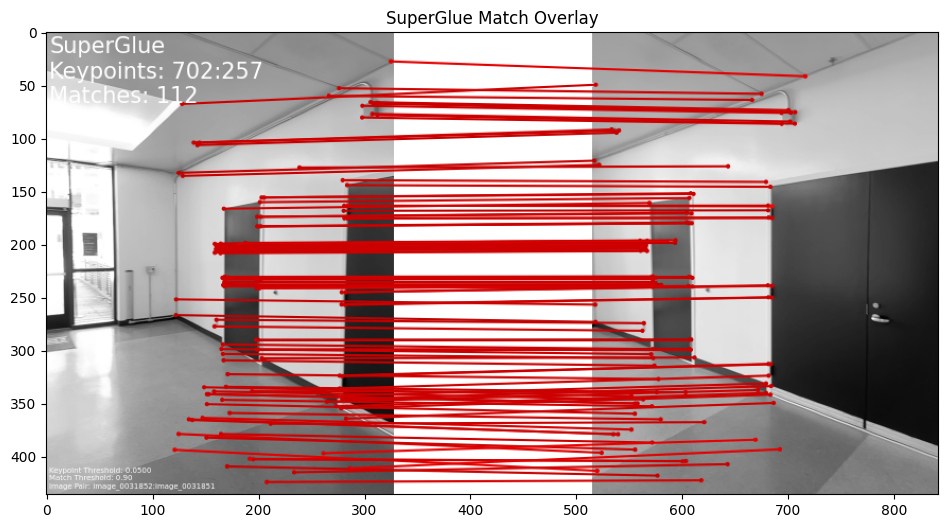

📐 Homography Matrix:
 [[ 1.54382834e+00  4.26531351e-02 -8.64823744e+02]
 [ 3.19640902e-01  1.39240834e+00 -3.41960589e+02]
 [ 3.71515909e-04  1.59005660e-05  1.00000000e+00]]


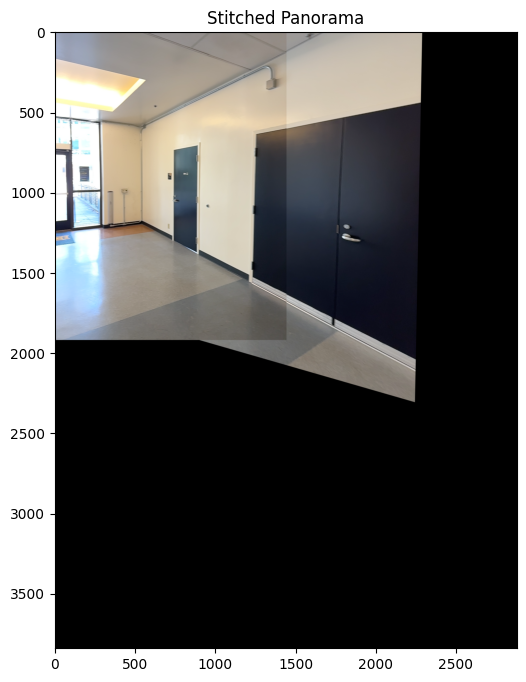

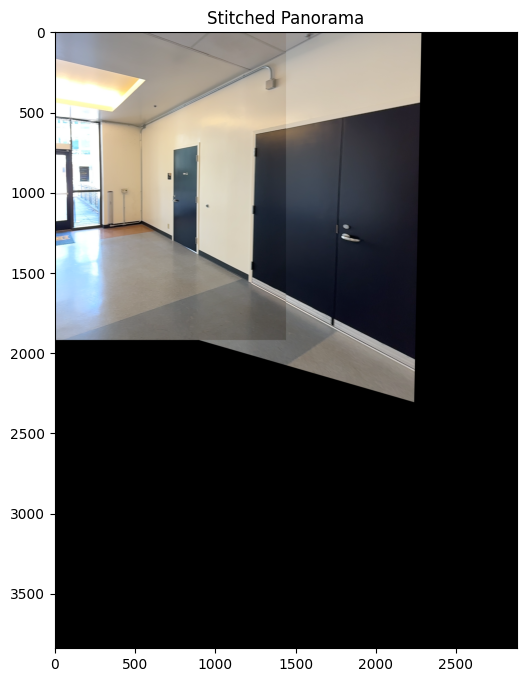

--------------------------------------------------------------------------------

🔍 Processing: image_0031851.png ↔ image_0031849.png
✅ Matched keypoints: 62


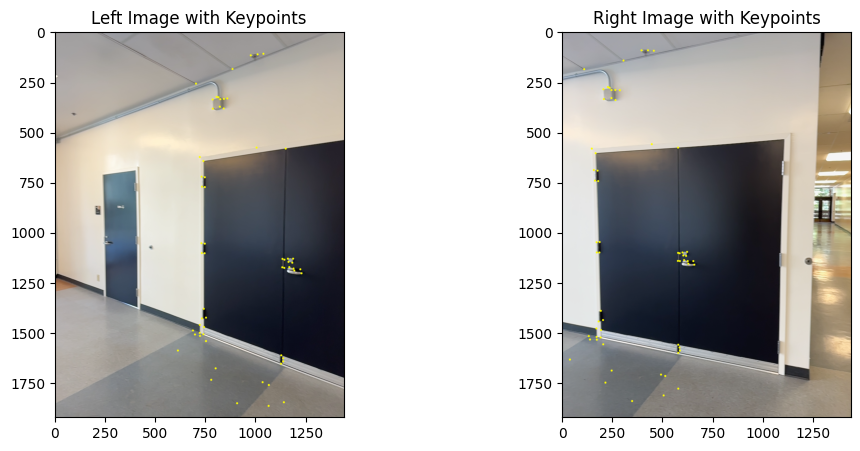

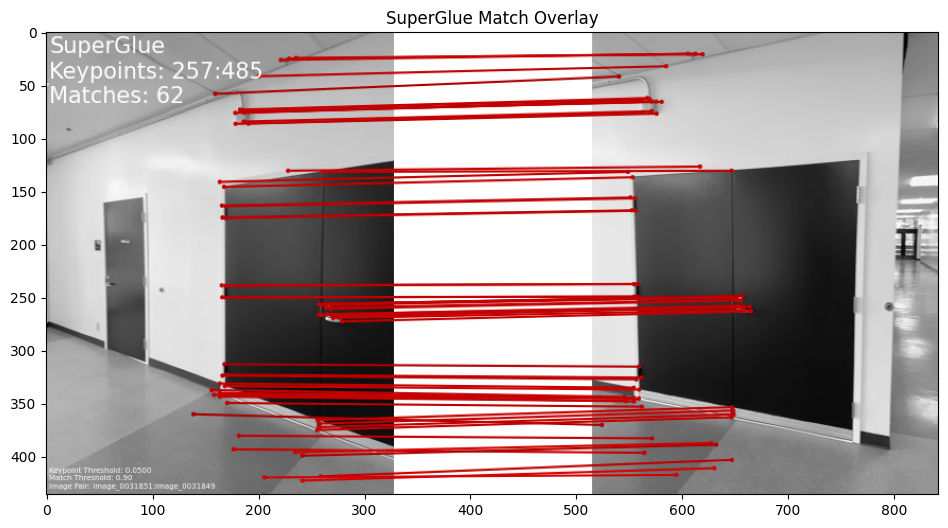

📐 Homography Matrix:
 [[ 1.38379856e+00  3.60483764e-02 -8.44191895e+02]
 [ 2.51870177e-01  1.28654926e+00 -2.79189777e+02]
 [ 2.93793352e-04 -4.22239814e-06  1.00000000e+00]]


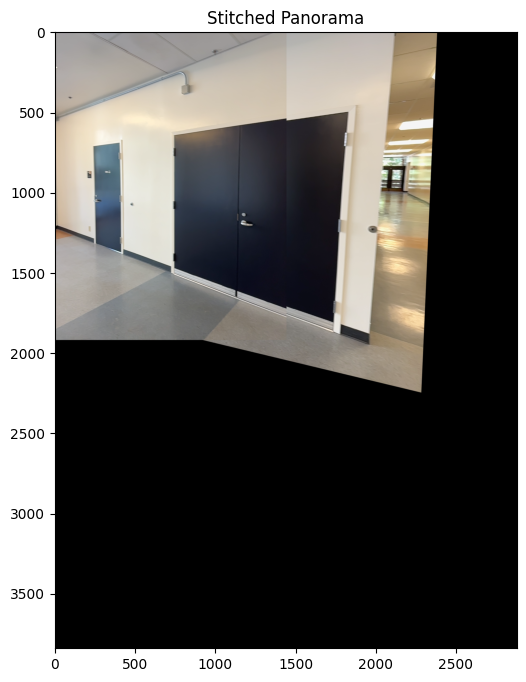

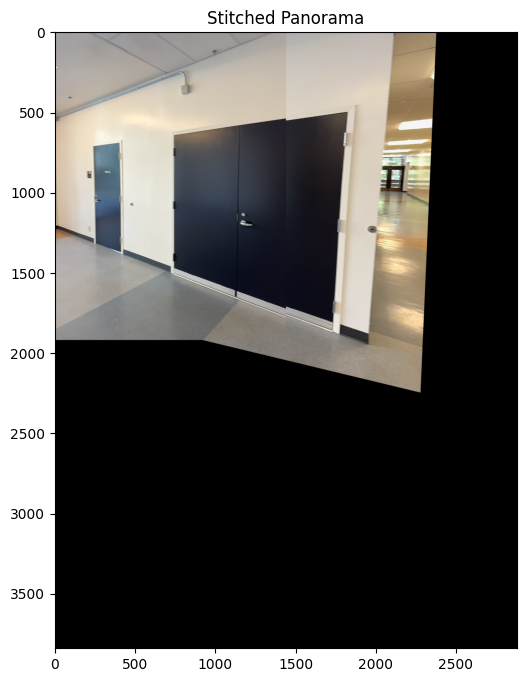

--------------------------------------------------------------------------------

🔍 Processing: image_0031849.png ↔ image_0031848.png
✅ Matched keypoints: 171


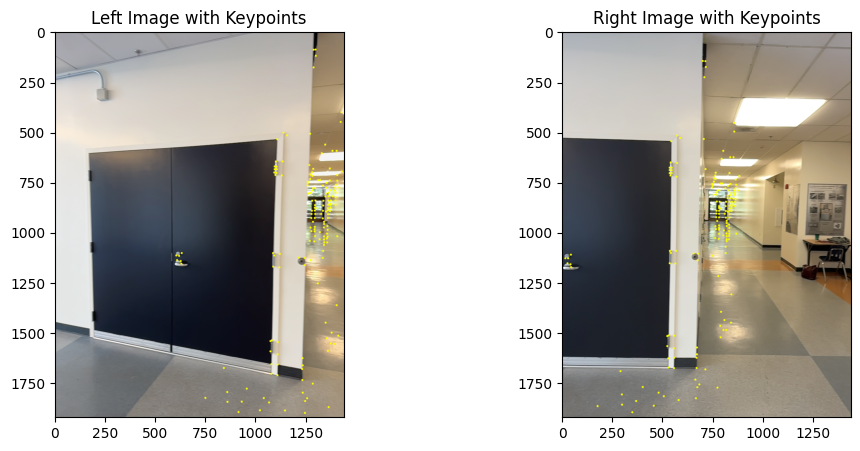

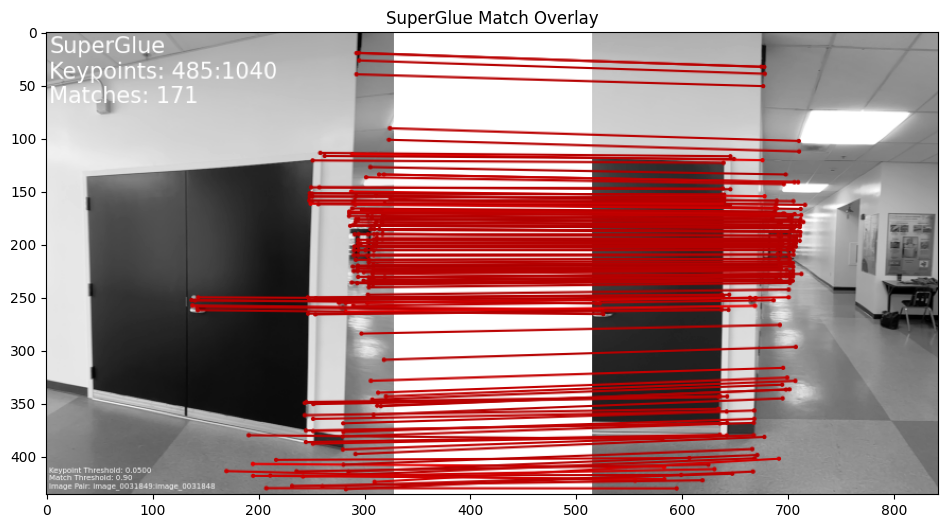

📐 Homography Matrix:
 [[ 3.21719527e+00  2.58288443e-01 -2.22674544e+03]
 [ 1.16882612e+00  2.81496236e+00 -1.55297990e+03]
 [ 1.16976386e-03  2.90777116e-04  1.00000000e+00]]


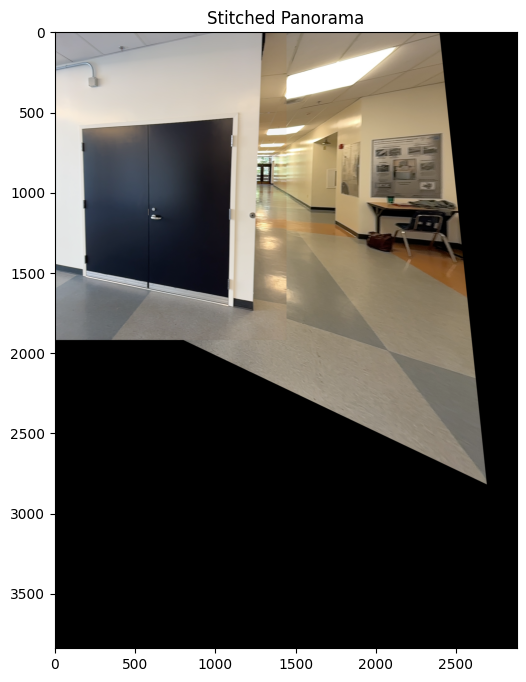

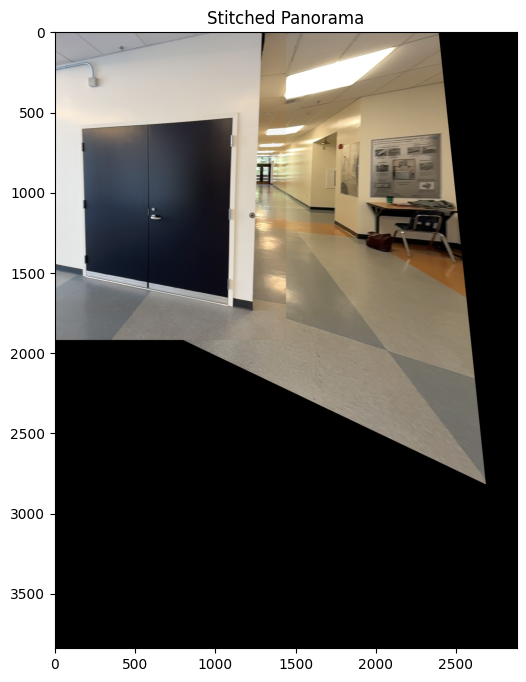

--------------------------------------------------------------------------------

🔍 Processing: image_0031848.png ↔ image_0031846.png
✅ Matched keypoints: 582


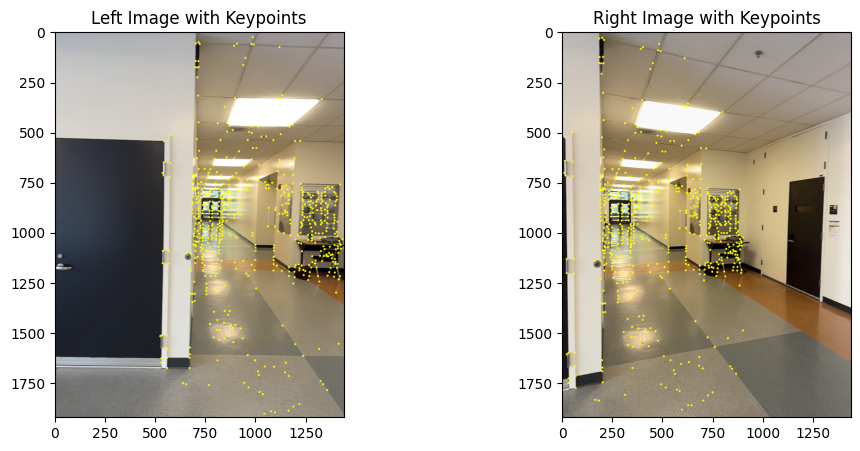

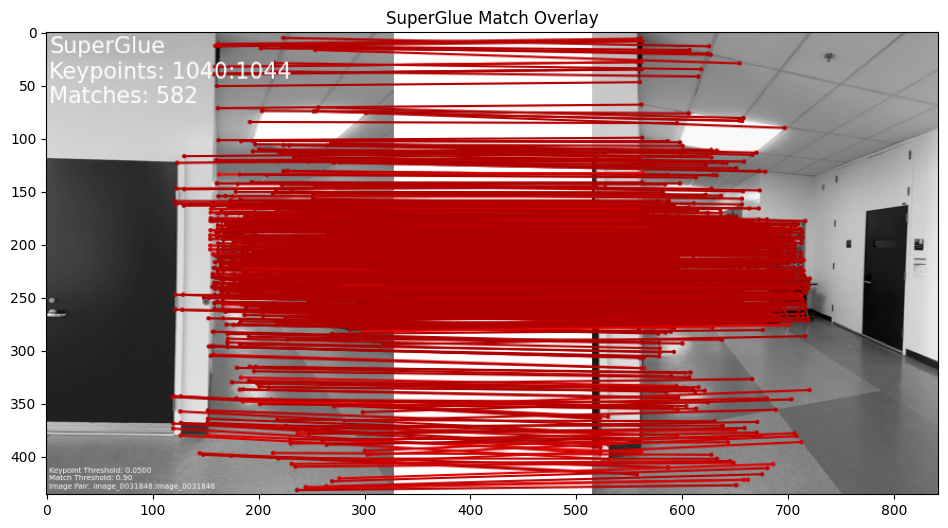

📐 Homography Matrix:
 [[ 1.63320609e+00  4.30064721e-02 -9.17858631e+02]
 [ 3.91694605e-01  1.40981123e+00 -3.49422359e+02]
 [ 4.44294441e-04 -7.42347349e-06  1.00000000e+00]]


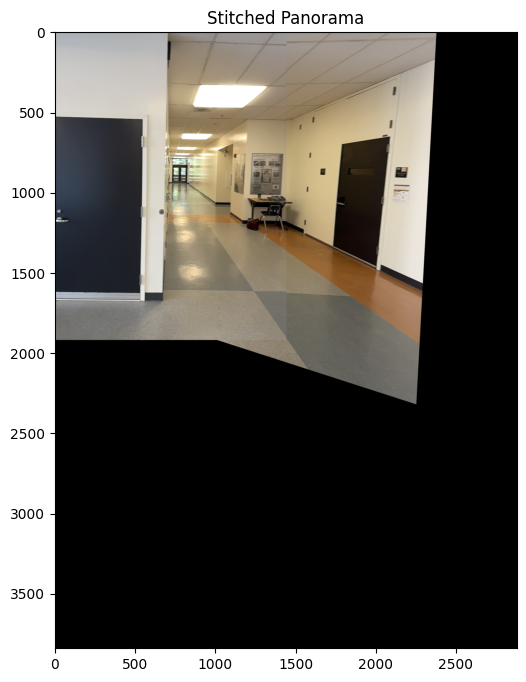

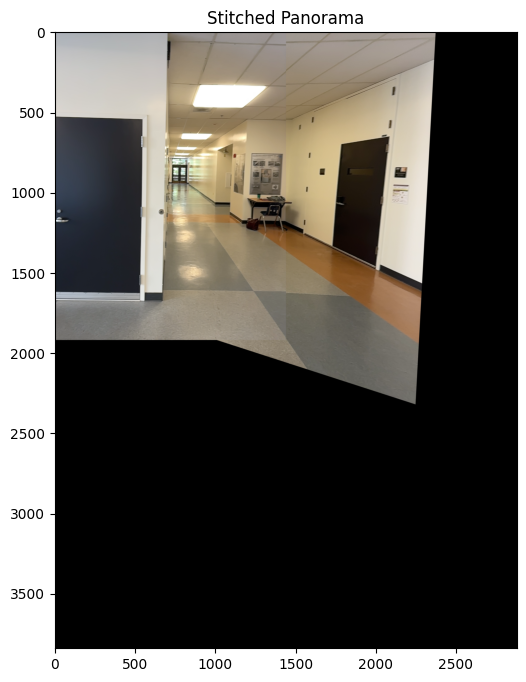

--------------------------------------------------------------------------------

🔍 Processing: image_0031846.png ↔ image_0031845.png
✅ Matched keypoints: 365


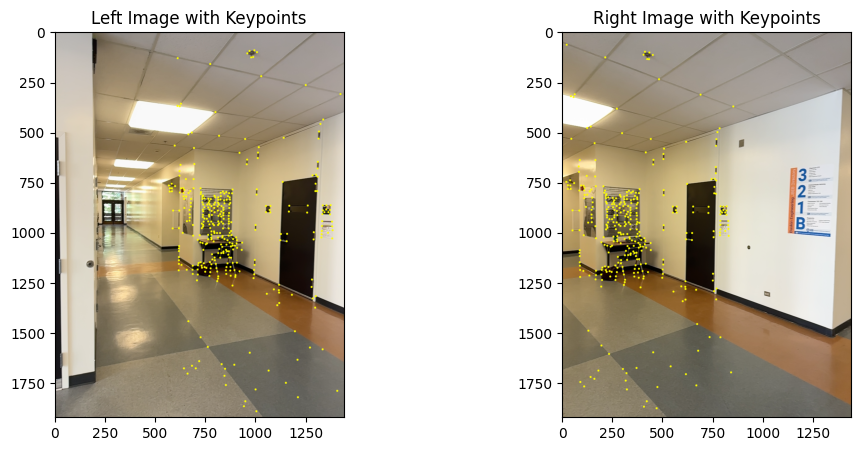

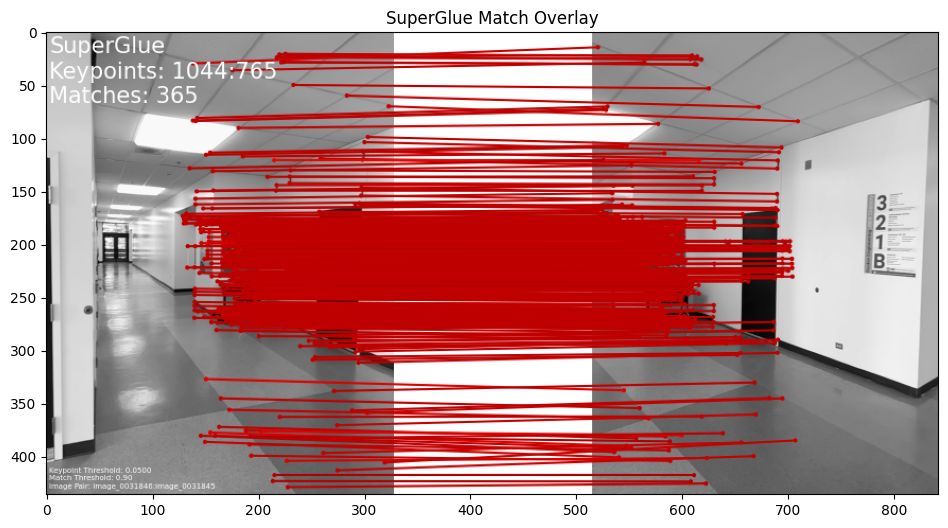

📐 Homography Matrix:
 [[ 1.56414387e+00  1.89538736e-02 -8.79029874e+02]
 [ 3.68306200e-01  1.36712194e+00 -3.41709647e+02]
 [ 4.07754416e-04 -1.40540872e-05  1.00000000e+00]]


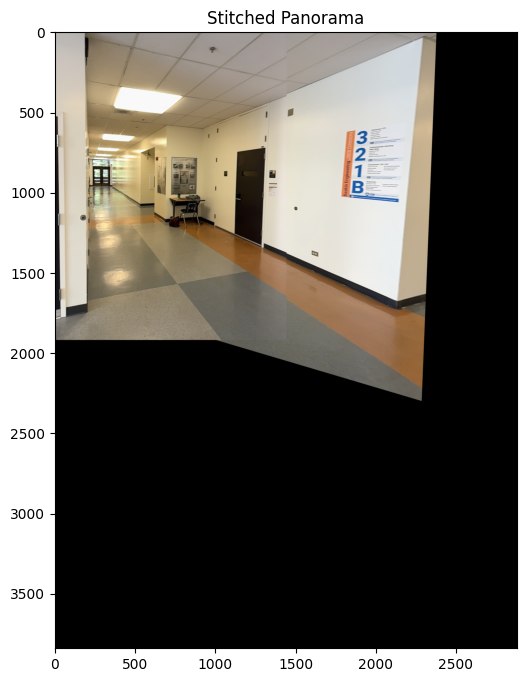

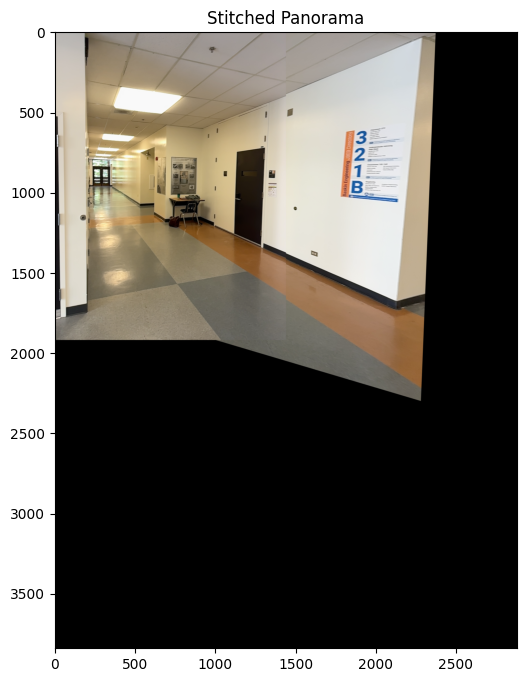

--------------------------------------------------------------------------------

🔍 Processing: image_0031845.png ↔ image_0031843.png
✅ Matched keypoints: 218


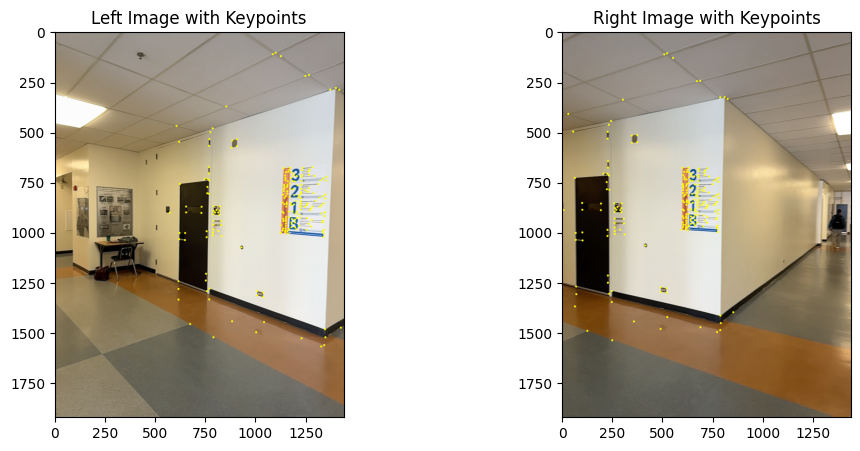

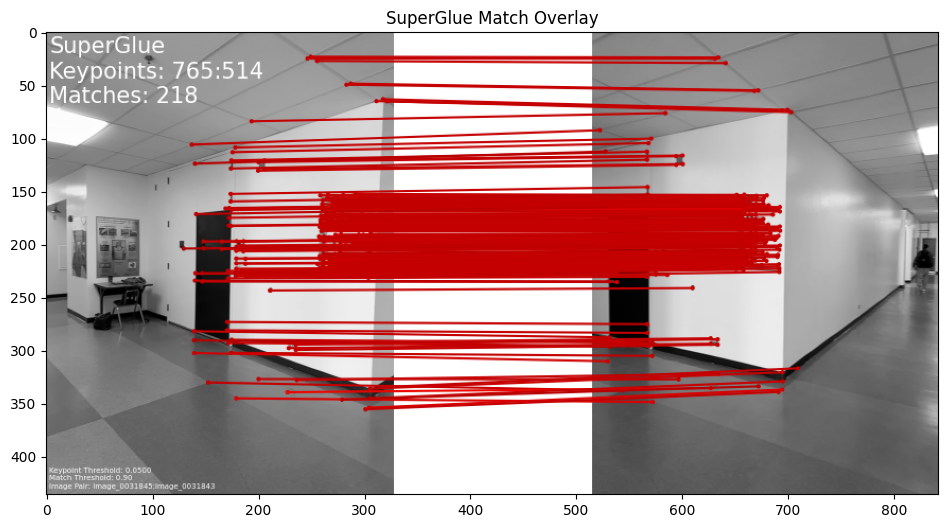

📐 Homography Matrix:
 [[ 1.56385924e+00  3.69814272e-02 -9.19771037e+02]
 [ 3.72872951e-01  1.41233368e+00 -3.83579903e+02]
 [ 4.15526214e-04  5.03157906e-06  1.00000000e+00]]


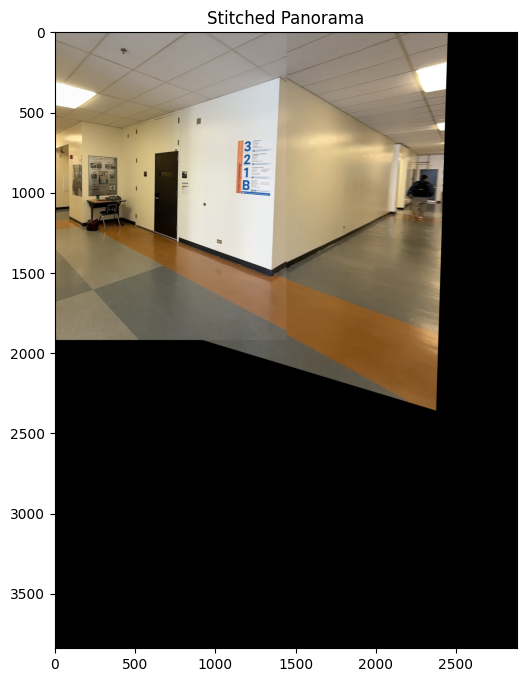

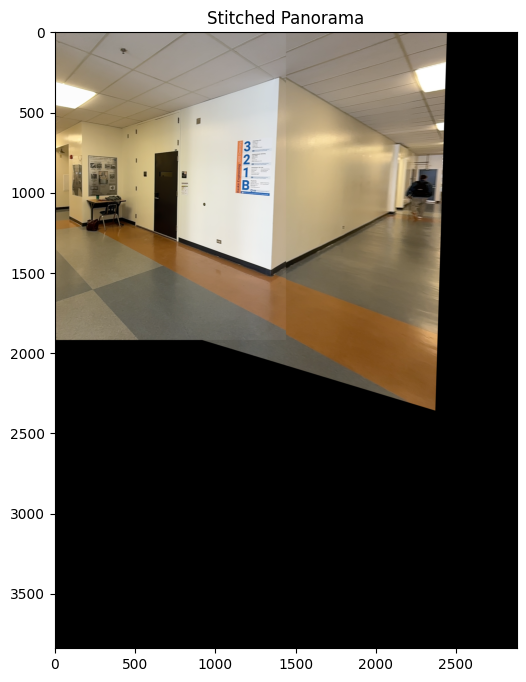

--------------------------------------------------------------------------------

🔍 Processing: image_0031843.png ↔ image_0031842.png
✅ Matched keypoints: 248


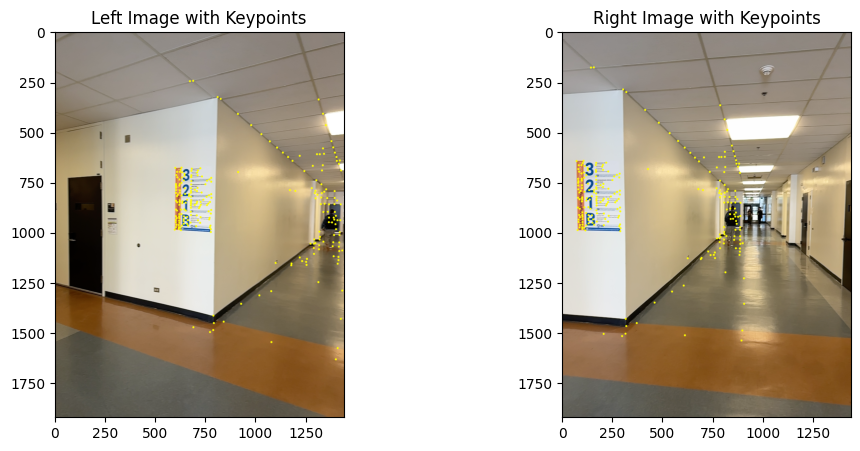

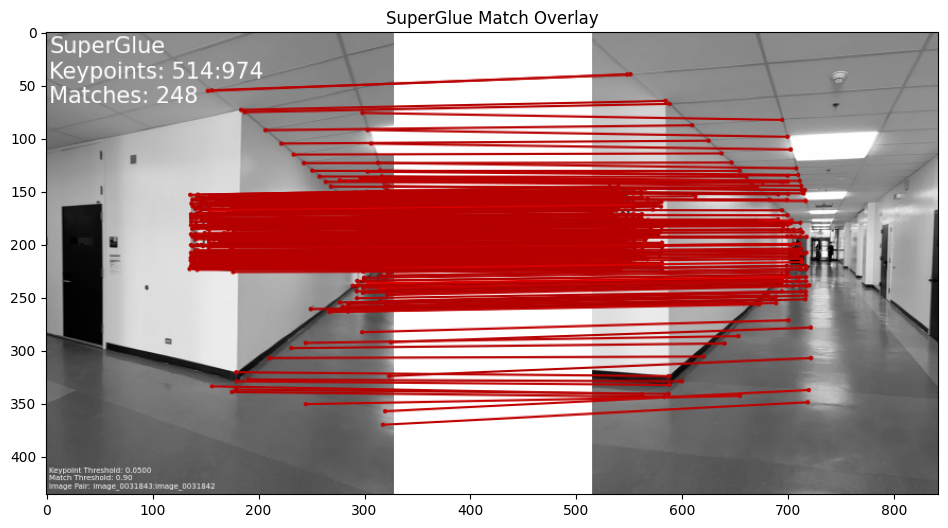

📐 Homography Matrix:
 [[ 1.64796966e+00  5.92860978e-02 -9.41254469e+02]
 [ 3.79834463e-01  1.46211271e+00 -4.01566664e+02]
 [ 4.35304866e-04  2.31190093e-05  1.00000000e+00]]


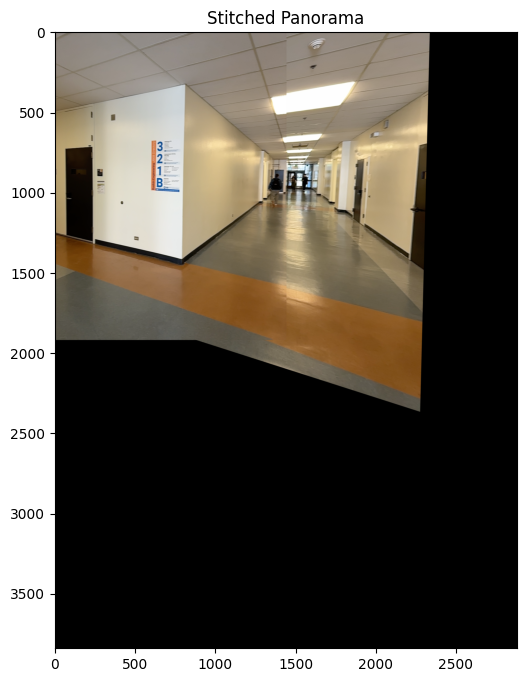

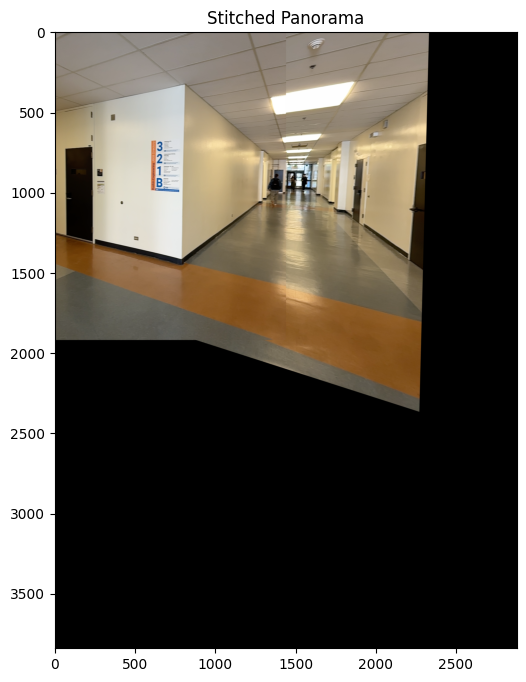

--------------------------------------------------------------------------------

🔍 Processing: image_0031842.png ↔ image_0031840.png
✅ Matched keypoints: 340


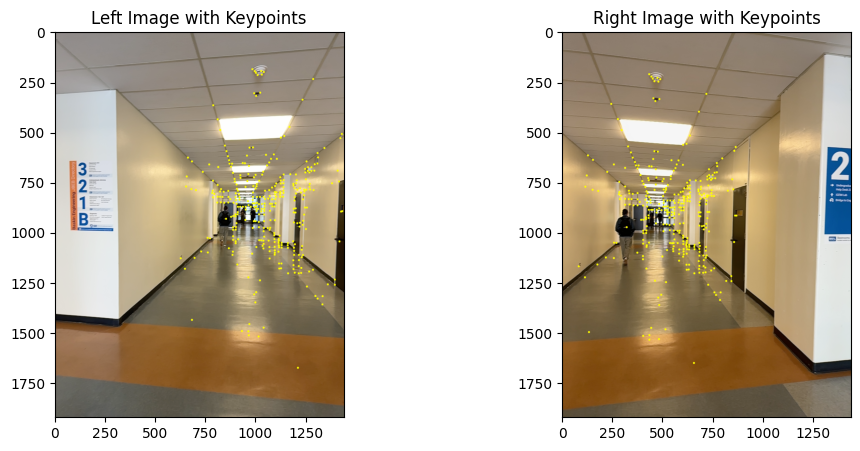

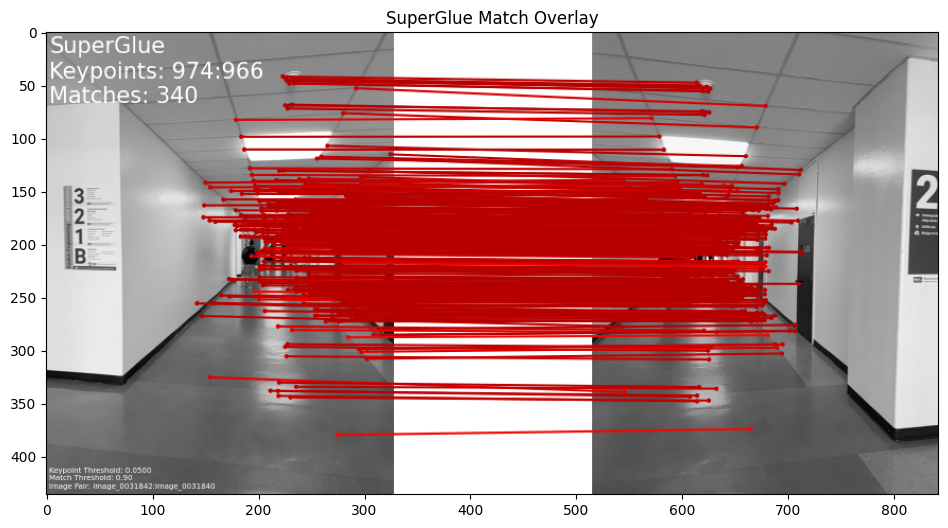

📐 Homography Matrix:
 [[ 1.66211688e+00 -2.58229076e-02 -8.67644865e+02]
 [ 5.13591150e-01  1.42487782e+00 -4.32513842e+02]
 [ 5.39433813e-04 -5.63199901e-05  1.00000000e+00]]


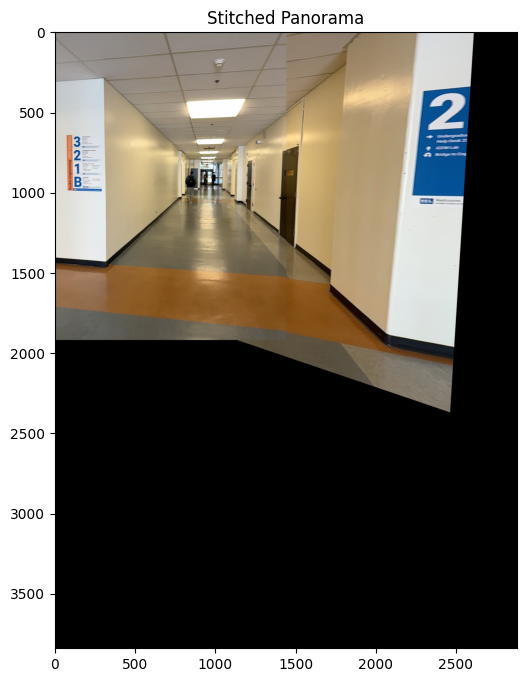

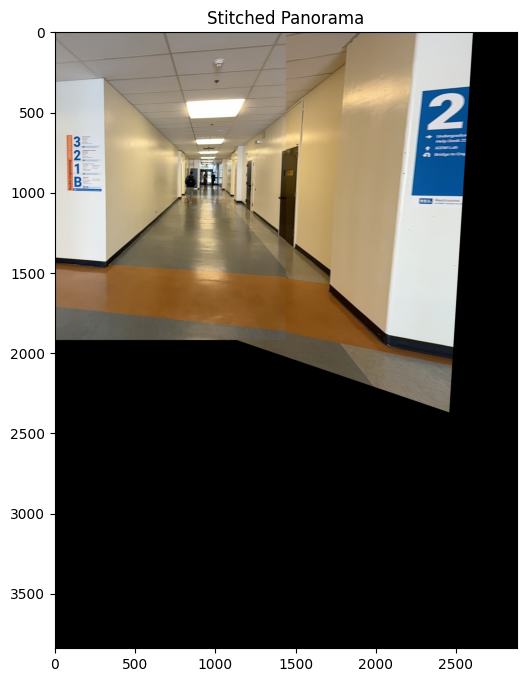

--------------------------------------------------------------------------------

🔍 Processing: image_0031840.png ↔ image_0031838.png
✅ Matched keypoints: 322


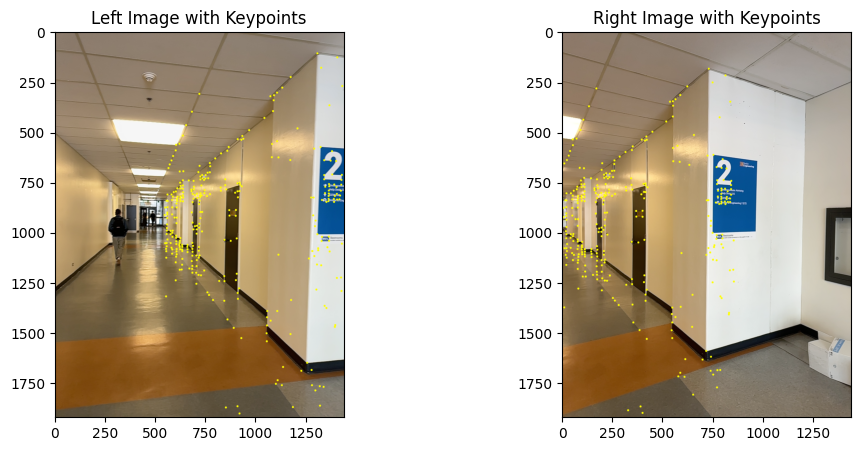

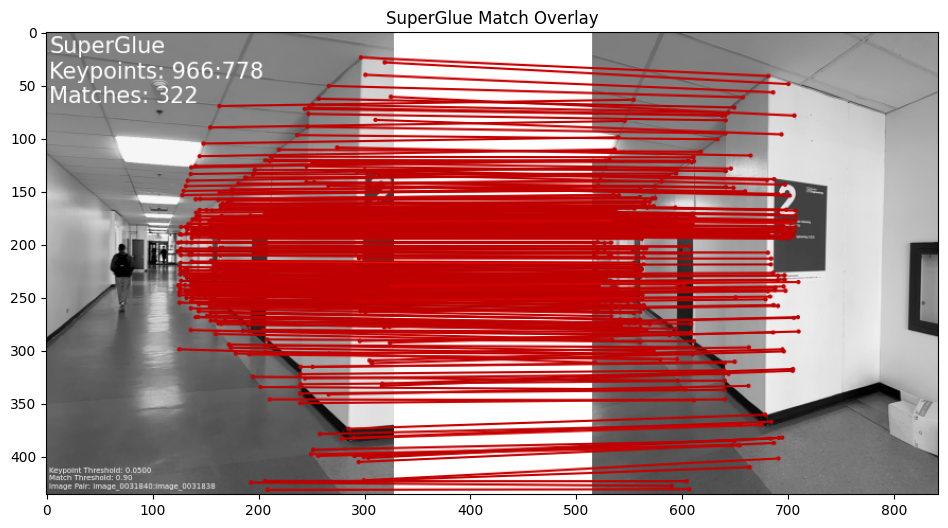

📐 Homography Matrix:
 [[ 1.57945976e+00  3.23282162e-02 -8.85942142e+02]
 [ 4.18674844e-01  1.44041335e+00 -3.88583673e+02]
 [ 4.63352107e-04  3.22633130e-06  1.00000000e+00]]


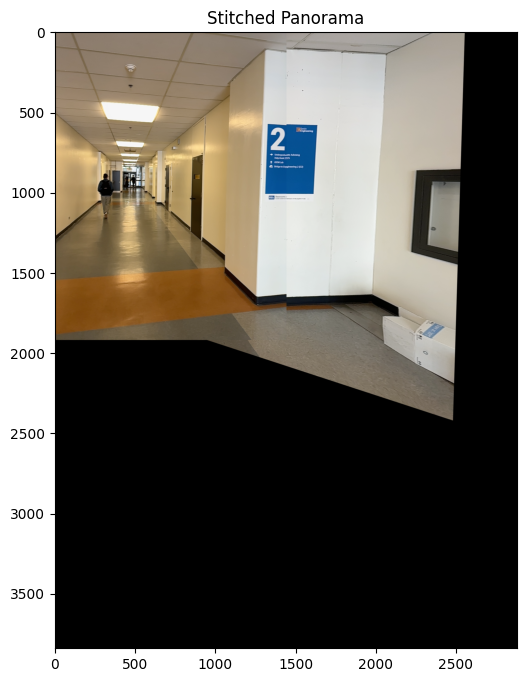

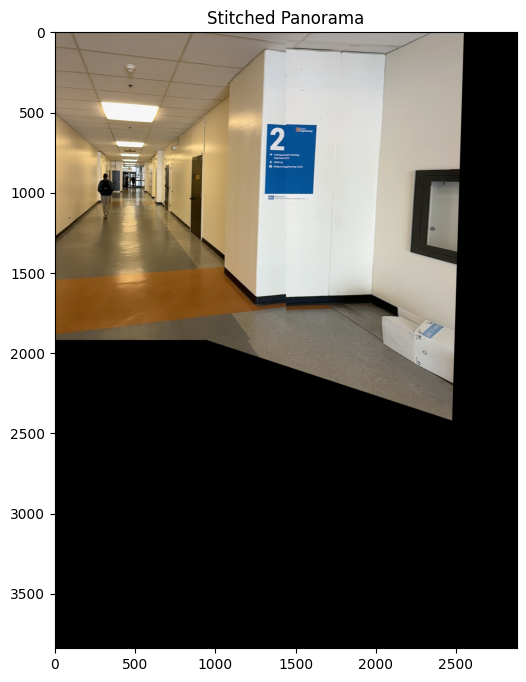

--------------------------------------------------------------------------------

🔍 Processing: image_0031838.png ↔ image_0031836.png
✅ Matched keypoints: 273


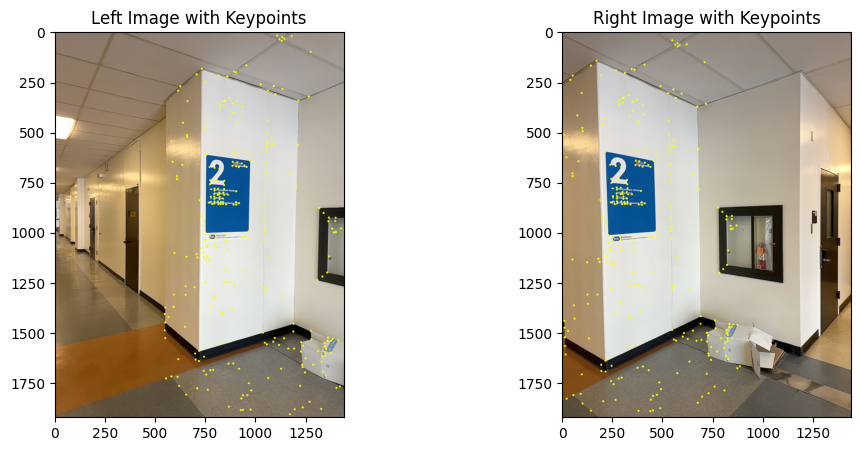

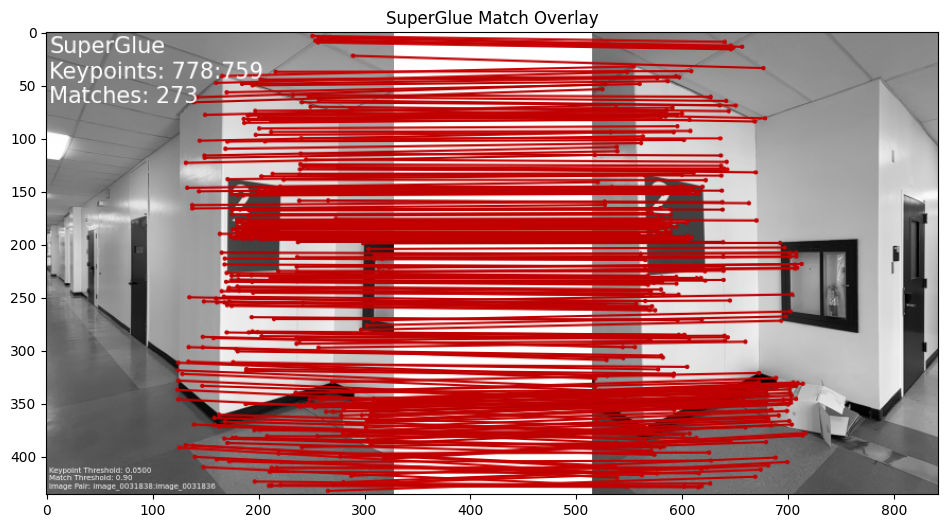

📐 Homography Matrix:
 [[ 1.54091129e+00  5.15036272e-02 -9.08734188e+02]
 [ 3.06708431e-01  1.38837925e+00 -3.14850029e+02]
 [ 3.63211902e-04  1.71484292e-05  1.00000000e+00]]


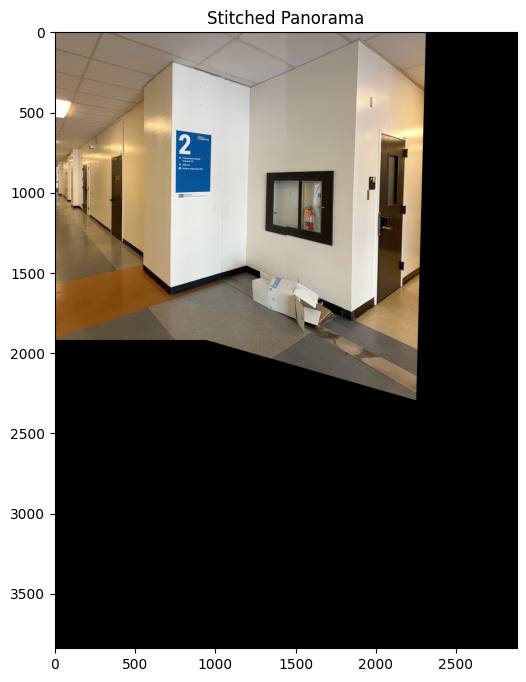

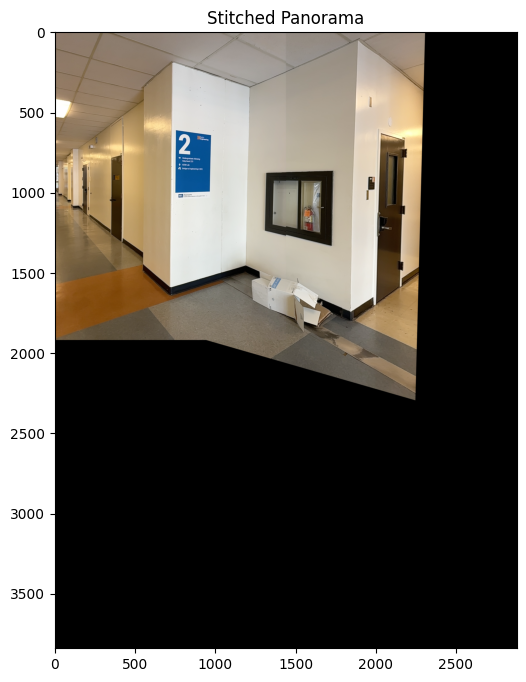

--------------------------------------------------------------------------------

🔍 Processing: image_0031836.png ↔ image_0031834.png
✅ Matched keypoints: 252


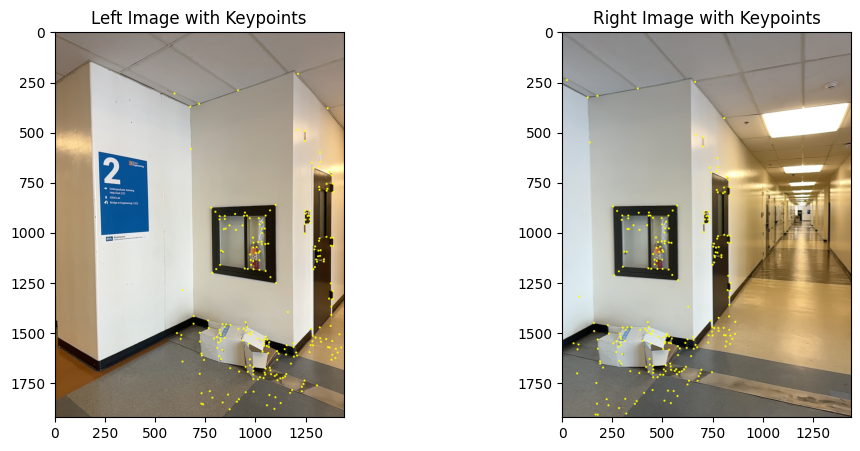

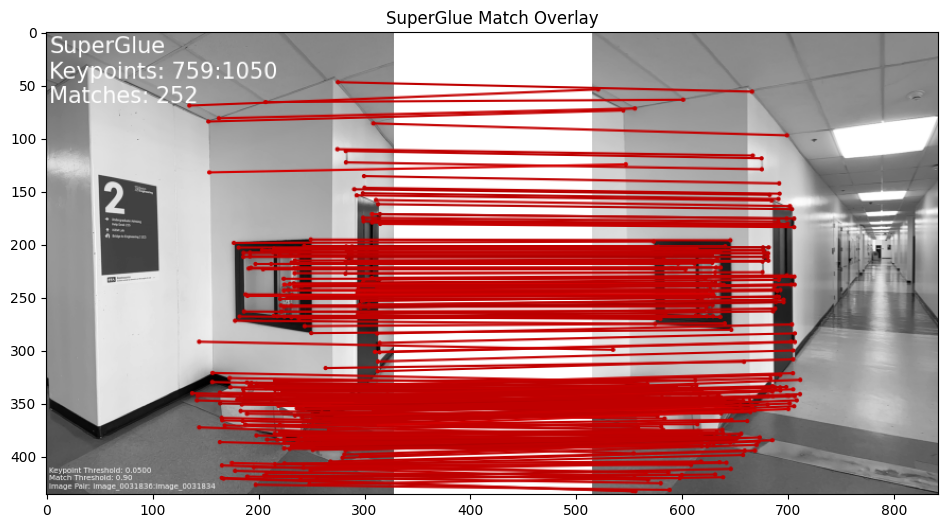

📐 Homography Matrix:
 [[ 1.40209643e+00 -3.32766526e-02 -7.49191352e+02]
 [ 2.58597591e-01  1.23954017e+00 -2.25686907e+02]
 [ 2.89770776e-04 -1.47344540e-05  1.00000000e+00]]


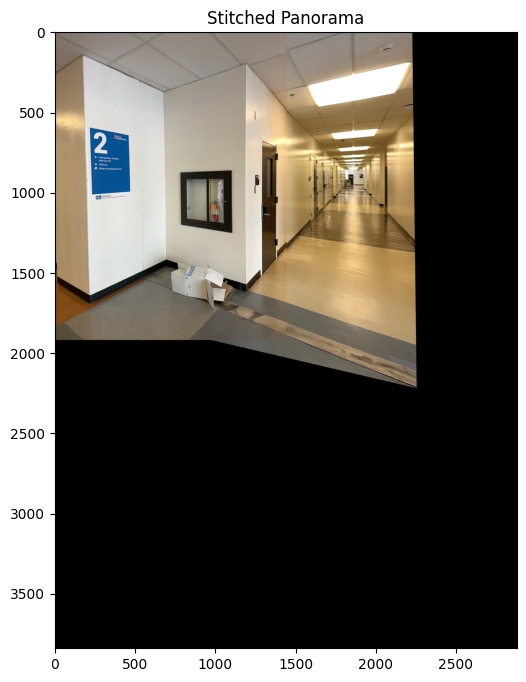

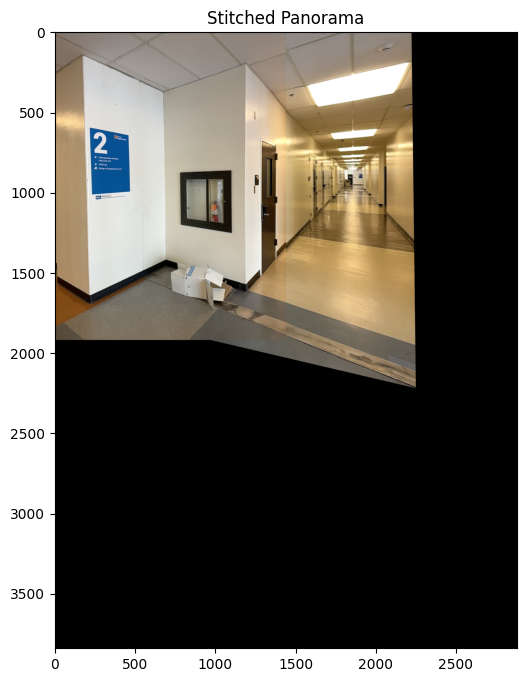

--------------------------------------------------------------------------------

🔍 Processing: image_0031834.png ↔ image_0031831.png
✅ Matched keypoints: 499


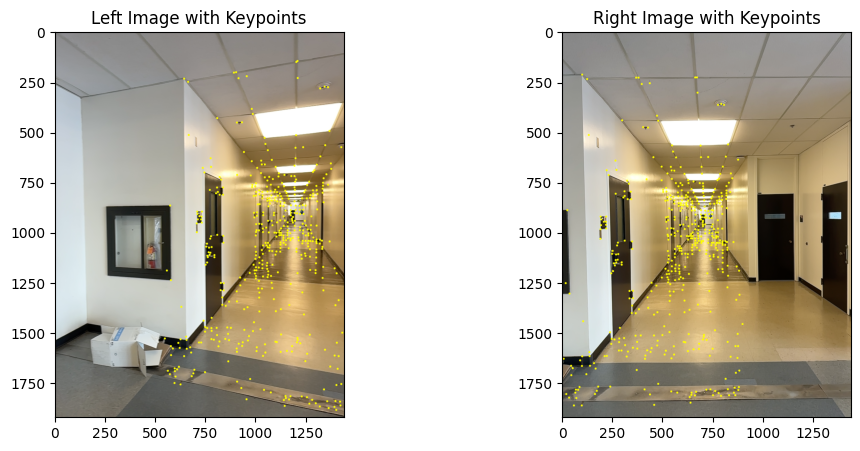

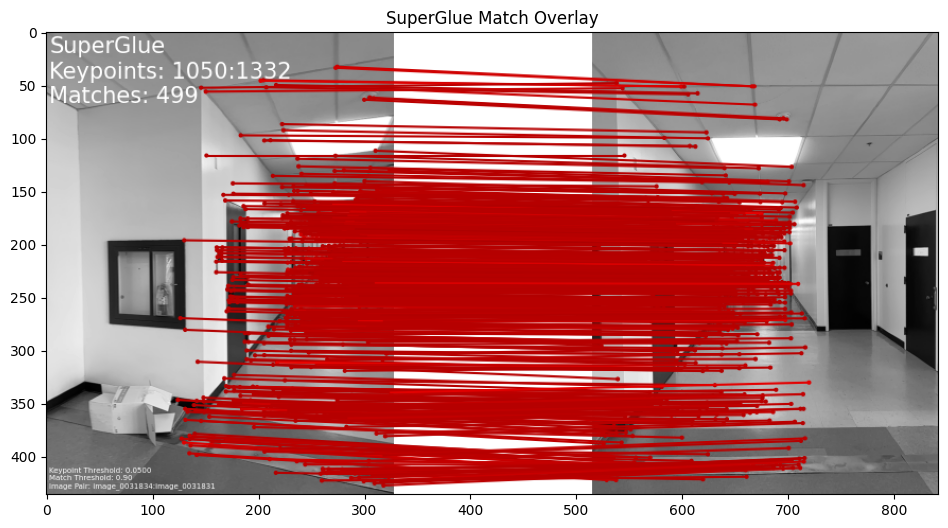

📐 Homography Matrix:
 [[ 1.88039816e+00  1.14353208e-02 -1.07778607e+03]
 [ 5.37702722e-01  1.48232098e+00 -4.43487866e+02]
 [ 5.95722764e-04 -5.27935017e-05  1.00000000e+00]]


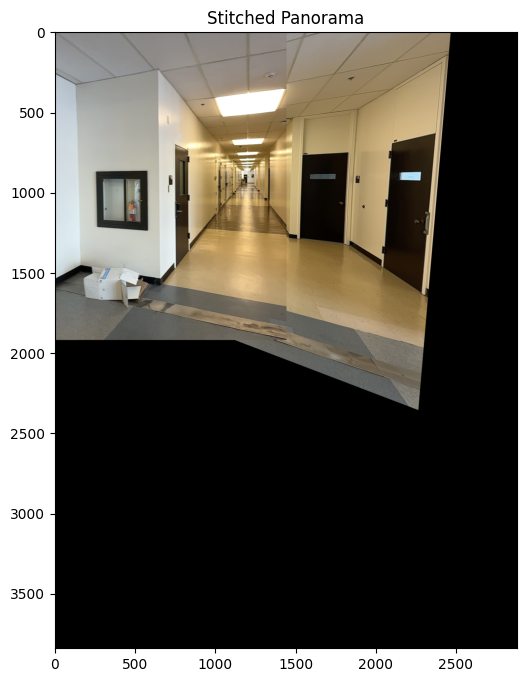

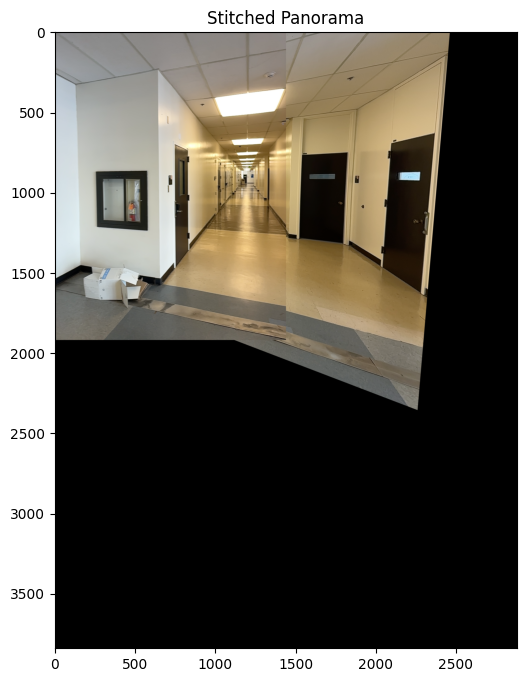

--------------------------------------------------------------------------------


In [21]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === PATHS ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")

# === STEP 1: Get sorted input images ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

print("✅ Sorted input images:", sorted_images)

# === STEP 2: Iterate through adjacent pairs ===
for i in range(len(sorted_images) - 1):
    img_left = sorted_images[i]
    img_right = sorted_images[i + 1]

    base_left = img_left.replace(".png", "")
    base_right = img_right.replace(".png", "")

    npz_file = f"{base_left}_{base_right}_matches.npz"
    match_img_file = f"{base_left}_{base_right}_matches.png"

    npz_path = os.path.join(output_dir, npz_file)
    match_img_path = os.path.join(output_dir, match_img_file)
    img_left_path = os.path.join(image_dir, img_left)
    img_right_path = os.path.join(image_dir, img_right)

    print(f"\n🔍 Processing: {img_left} ↔ {img_right}")

    if not os.path.exists(npz_path):
        print(f"❌ Missing .npz file: {npz_path}")
        continue

    # === Load SuperGlue matches ===
    npz = np.load(npz_path)
    matches = npz['matches']
    keypoints0 = npz['keypoints0']
    keypoints1 = npz['keypoints1']
    conf = npz['match_confidence']

    # Filter matched points
    matched_idx = matches > -1
    point_set1 = keypoints0[matched_idx]
    point_set2 = keypoints1[matches[matched_idx]]

    print(f"✅ Matched keypoints: {len(point_set1)}")

    # === Load images ===
    im_left = cv.imread(img_left_path)
    im_right = cv.imread(img_right_path)

    # === Draw keypoints ===
    im_left_vis = im_left.copy()
    im_right_vis = im_right.copy()
    for pt in point_set1.astype(np.int32):
        cv.circle(im_left_vis, tuple(pt), 5, (0, 255, 255), -1)
    for pt in point_set2.astype(np.int32):
        cv.circle(im_right_vis, tuple(pt), 5, (0, 255, 255), -1)

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(im_left_vis[..., ::-1])
    plt.title("Left Image with Keypoints")
    plt.subplot(1, 2, 2)
    plt.imshow(im_right_vis[..., ::-1])
    plt.title("Right Image with Keypoints")
    plt.show()

    # === Optional: Show SuperGlue match image ===
    if os.path.exists(match_img_path):
        match_img = cv.imread(match_img_path)
        plt.figure(figsize=(12, 6))
        plt.imshow(match_img[..., ::-1])
        plt.title("SuperGlue Match Overlay")
        plt.show()

    # === Estimate Homography ===
    H, status = cv.findHomography(point_set1, point_set2, cv.RANSAC, 5.0)
    if H is None:
        print("⚠️ Homography estimation failed.")
        continue

    print("📐 Homography Matrix:\n", H)

    # === Warp and blend ===
    panorama = cv.warpPerspective(im_right, np.linalg.inv(H), (1500, 800))
    # === Resize canvas to fit both images ===
    height, width = im_left.shape[:2]
    canvas_size = (width * 2, height * 2)

    # === Warp with safe canvas ===
    panorama = cv.warpPerspective(im_right, np.linalg.inv(H), canvas_size)

    # === Overlay the left image ===
    panorama[0:height, 0:width] = im_left

    # === Display result ===
    plt.figure(figsize=(12, 8))
    plt.imshow(panorama[..., ::-1])
    plt.title("Stitched Panorama")
    plt.show()
    plt.figure(figsize=(10, 8))
    plt.imshow(panorama[..., ::-1])
    plt.title("Stitched Panorama")
    plt.show()

    print("-" * 80)


In [ ]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === PATHS ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")

# === LOAD SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === REFERENCE IMAGE ===
ref_idx = 0
ref_image = cv.imread(os.path.join(image_dir, sorted_images[ref_idx]))
h, w = ref_image.shape[:2]

H_chain = [np.eye(3)]
corner_list = []

# === CHAIN HOMOGRAPHIES (right to left) ===
for i in range(1, len(sorted_images)):
    img1 = sorted_images[i - 1]
    img2 = sorted_images[i]
    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")

    if not os.path.exists(npz_path):
        print(f"❌ Missing: {npz_path}")
        H_chain.append(H_chain[-1])  # duplicate last
        continue

    data = np.load(npz_path)
    matches = data['matches']
    kp0 = data['keypoints0']
    kp1 = data['keypoints1']
    valid = matches > -1

    if np.sum(valid) < 4:
        print(f"⚠️ Too few matches: {img1} ↔ {img2}")
        H_chain.append(H_chain[-1])
        continue

    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    H, _ = cv.findHomography(pts1, pts0, cv.RANSAC, 5.0)

    if H is None:
        print(f"⚠️ Homography failed for {img2}")
        H_chain.append(H_chain[-1])
    else:
        H_chain.append(H_chain[-1] @ H)

# === TRANSFORM CORNERS OF EACH IMAGE ===
for i in range(len(sorted_images)):
    img = cv.imread(os.path.join(image_dir, sorted_images[i]))
    h, w = img.shape[:2]
    corners = np.array([[0, 0], [w, 0], [w, h], [0, h]], dtype=np.float32).reshape(-1, 1, 2)
    warped_corners = cv.perspectiveTransform(corners, H_chain[i])
    corner_list.append(warped_corners)

# === FILTER BAD HOMOGRAPHIES (Step 3) ===
VALID_H_CHAIN = [H_chain[0]]
VALID_sorted_images = [sorted_images[0]]
VALID_corner_list = [corner_list[0]]

for i in range(1, len(sorted_images)):
    corners = corner_list[i].reshape(-1, 2)
    width = np.ptp(corners[:, 0])
    height = np.ptp(corners[:, 1])
    if width > 10000 or height > 10000:
        print(f"⚠️ Skipping {sorted_images[i]} due to huge warp: {width:.1f} x {height:.1f}")
        continue
    VALID_H_CHAIN.append(H_chain[i])
    VALID_sorted_images.append(sorted_images[i])
    VALID_corner_list.append(corner_list[i])

# === BOUNDING BOX FROM VALID CORNERS ===
all_corners = np.vstack(VALID_corner_list)
[x_min, y_min] = np.floor(all_corners.min(axis=0).ravel()).astype(int)
[x_max, y_max] = np.ceil(all_corners.max(axis=0).ravel()).astype(int)

canvas_w = x_max - x_min
canvas_h = y_max - y_min
MAX_CANVAS_SIZE = 10000

if canvas_w > MAX_CANVAS_SIZE or canvas_h > MAX_CANVAS_SIZE:
    raise MemoryError(f"🚨 Canvas too large: {canvas_w} x {canvas_h}. Try filtering more or reducing image count.")

print(f"🖼️ Canvas size: {canvas_w} x {canvas_h}")



⚠️ Skipping image_0031855.png due to huge warp: 185986.1 x 146147.2
⚠️ Skipping image_0031851.png due to huge warp: 17281.5 x 18468.0
⚠️ Skipping image_0031843.png due to huge warp: 15983.9 x 12677.0
⚠️ Skipping image_0031840.png due to huge warp: 20735.8 x 16927.7


MemoryError: 🚨 Canvas too large: 12938 x 8461. Try filtering more or reducing image count.

✅ Added image_0031858.png ↔ image_0031857.png to canvas
✅ Added image_0031857.png ↔ image_0031856.png to canvas
✅ Added image_0031856.png ↔ image_0031855.png to canvas
✅ Added image_0031855.png ↔ image_0031853.png to canvas
✅ Added image_0031853.png ↔ image_0031852.png to canvas
✅ Added image_0031852.png ↔ image_0031851.png to canvas
✅ Added image_0031851.png ↔ image_0031849.png to canvas
✅ Added image_0031849.png ↔ image_0031848.png to canvas
✅ Added image_0031848.png ↔ image_0031846.png to canvas
✅ Added image_0031846.png ↔ image_0031845.png to canvas


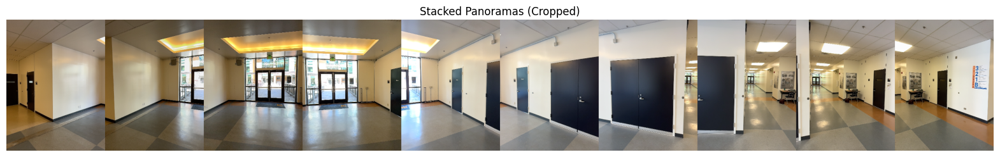

In [28]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")

tile_height = 400
tile_width_max = 1000  # max width per stitched pair
max_pairs = 10         # adjust based on how many pairs you want
canvas_height = tile_height
canvas_width = tile_width_max * max_pairs
canvas = np.zeros((canvas_height, canvas_width, 3), dtype=np.uint8)

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

canvas_x = 0  # where to place next tile

for i in range(min(len(sorted_images) - 1, max_pairs)):
    img1 = sorted_images[i]
    img2 = sorted_images[i + 1]
    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")

    if not os.path.exists(npz_path):
        print(f"❌ Missing: {npz_path}")
        continue

    data = np.load(npz_path)
    matches = data['matches']
    kp0 = data['keypoints0']
    kp1 = data['keypoints1']
    valid = matches > -1
    if np.sum(valid) < 4:
        print(f"⚠️ Too few matches: {img1} ↔ {img2}")
        continue

    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    H, _ = cv.findHomography(pts0, pts1, cv.RANSAC, 5.0)

    if H is None:
        print(f"⚠️ Homography failed for {img1} ↔ {img2}")
        continue

    im1 = cv.imread(os.path.join(image_dir, img1))
    im2 = cv.imread(os.path.join(image_dir, img2))

    # Warp im1 to im2
    # Warp im1 into im2's coordinate space
    warp_w = im2.shape[1] * 2
    warp_h = im2.shape[0]
    warped = cv.warpPerspective(im1, H, (warp_w, warp_h))
    warped[0:im2.shape[0], 0:im2.shape[1]] = im2

    # --- Crop the non-black region ---
    gray = cv.cvtColor(warped, cv.COLOR_BGR2GRAY)
    _, thresh = cv.threshold(gray, 1, 255, cv.THRESH_BINARY)
    coords = cv.findNonZero(thresh)

    if coords is None:
        print(f"⚠️ Empty warped result for {img1} ↔ {img2}, skipping...")
        continue

    x, y, w, h = cv.boundingRect(coords)
    cropped = warped[y:y + h, x:x + w]

    # Resize result
   # Resize cropped tile
    scale = tile_height / h
    new_w = int(w * scale)
    resized_tile = cv.resize(cropped, (new_w, tile_height))

    # Paste into canvas
    if canvas_x + new_w > canvas_width:
        print("🛑 Canvas limit reached")
        break
    canvas[0:tile_height, canvas_x:canvas_x + new_w] = resized_tile
    canvas_x += new_w

    print(f"✅ Added {img1} ↔ {img2} to canvas")

    final_canvas = canvas[:, :canvas_x]

# === SHOW RESULT ===
plt.figure(figsize=(20, 8))
plt.imshow(final_canvas[..., ::-1])
plt.title("Stacked Panoramas (Cropped)")
plt.axis('off')
plt.show()


In [1]:

def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]  # Focal length
    cyl = np.zeros_like(img)

    # Coordinates in image
    y_i, x_i = np.indices((h, w))
    x = x_i - w / 2
    y = y_i - h / 2

    # Convert to cylindrical coordinates
    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)

    x_c = f * theta + w / 2
    y_c = f * h_ + h / 2

    # Map pixels
    map_x = x_c.astype(np.float32)
    map_y = y_c.astype(np.float32)
    cyl = cv.remap(img, map_x, map_y, interpolation=cv.INTER_LINEAR)
    return cyl

In [ ]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")

tile_height = 400
tile_width_max = 1000
max_pairs = 10

# === SORTED IMAGE PAIRS ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

tile_list = []
tile_names = []

# === STEP 1: Generate cropped, resized stitched tiles ===
for i in range(min(len(sorted_images) - 1, max_pairs)):
    img1 = sorted_images[i]
    img2 = sorted_images[i + 1]
    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")

    if not os.path.exists(npz_path):
        print(f"❌ Missing: {npz_path}")
        continue

    data = np.load(npz_path)
    matches = data['matches']
    kp0 = data['keypoints0']
    kp1 = data['keypoints1']
    valid = matches > -1
    if np.sum(valid) < 4:
        print(f"⚠️ Too few matches: {img1} ↔ {img2}")
        continue

    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    H, _ = cv.findHomography(pts0, pts1, cv.RANSAC, 5.0)
    
    if H is None:
        print(f"⚠️ Homography failed for {img1} ↔ {img2}")
        continue

    im1 = cv.imread(os.path.join(image_dir, img1))
    im2 = cv.imread(os.path.join(image_dir, img2))

    #read in intrinsics
    K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
    ])

    warpedim1 = cylindrical_warp(im1, K)
    warpedim2 = cylindrical_warp(im2, K)

    warped = np.hstack((warpedim1, warpedim2))

    # Crop non-black region
    gray = cv.cvtColor(warped, cv.COLOR_BGR2GRAY)
    _, thresh = cv.threshold(gray, 1, 255, cv.THRESH_BINARY)
    coords = cv.findNonZero(thresh)

    x, y, w, h = cv.boundingRect(coords)
    cropped = warped[y:y + h, x:x + w]

    # Resize tile
    scale = tile_height / h
    new_w = int(w * scale)
    resized_tile = cv.resize(cropped, (new_w, tile_height))
    

    tile_list.append(resized_tile)
    tile_names.append(f"{img1} ↔ {img2}")
    print(f"✅ Generated tile {i}: {img1} ↔ {img2}")


NameError: name 'canvas_width' is not defined

✅ Warped image 0: image_0031858.png
✅ Warped image 1: image_0031857.png
✅ Warped image 2: image_0031856.png
✅ Warped image 3: image_0031855.png
✅ Warped image 4: image_0031853.png
✅ Warped image 5: image_0031852.png
✅ Warped image 6: image_0031851.png
✅ Warped image 7: image_0031849.png
✅ Warped image 8: image_0031848.png
✅ Warped image 9: image_0031846.png


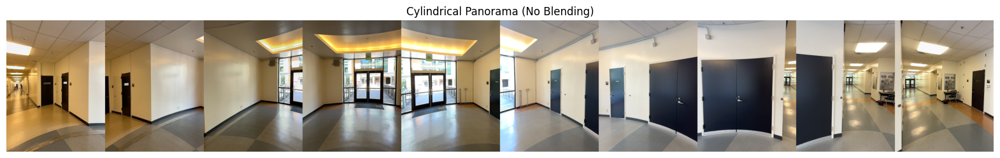

In [8]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
max_images = 10

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

# === CYLINDRICAL WARP FUNCTION ===
def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]

    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]

    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)

    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]

    map_x = x_map.astype(np.float32)
    map_y = y_map.astype(np.float32)

    cyl = cv.remap(img, map_x, map_y, interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)
    return cyl

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === WARP & CONCATENATE IMAGES ===
warped_images = []
for i, name in enumerate(sorted_images[:max_images]):
    img_path = os.path.join(image_dir, name)
    img = cv.imread(img_path)

    if img is None:
        print(f"❌ Failed to load {name}")
        continue

    warped = cylindrical_warp(img, K)
    warped_images.append(warped)
    print(f"✅ Warped image {i}: {name}")

# === BUILD PANORAMA CANVAS ===
heights = [img.shape[0] for img in warped_images]
widths = [img.shape[1] for img in warped_images]
total_width = sum(widths)
max_height = max(heights)

panorama = np.zeros((max_height, total_width, 3), dtype=np.uint8)

current_x = 0
for warped in warped_images:
    h, w = warped.shape[:2]
    panorama[0:h, current_x:current_x + w] = warped
    current_x += w

# === VISUALIZE RESULT ===
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(panorama, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (No Blending)")
plt.axis('off')
plt.show()


✅ Warped image 0: image_0031858.png
✅ Warped image 1: image_0031857.png
✅ Warped image 2: image_0031856.png
✅ Warped image 3: image_0031855.png
✅ Warped image 4: image_0031853.png
✅ Warped image 5: image_0031852.png
✅ Warped image 6: image_0031851.png
✅ Warped image 7: image_0031849.png
✅ Warped image 8: image_0031848.png
✅ Warped image 9: image_0031846.png
✅ Warped image 10: image_0031845.png
✅ Warped image 11: image_0031843.png
✅ Warped image 12: image_0031842.png
✅ Warped image 13: image_0031840.png
✅ Warped image 14: image_0031838.png
✅ Warped image 15: image_0031836.png
✅ Warped image 16: image_0031834.png
✅ Warped image 17: image_0031831.png


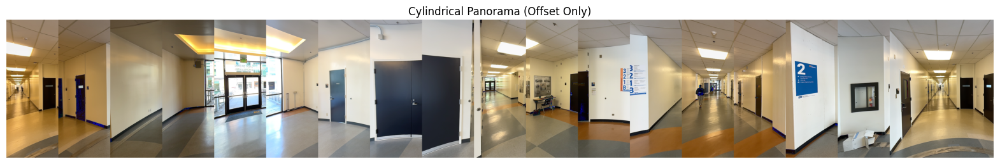

In [8]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
max_images = 20

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

# === CYLINDRICAL WARP FUNCTION ===
def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]

    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]

    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)

    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]

    map_x = x_map.astype(np.float32)
    map_y = y_map.astype(np.float32)

    return cv.remap(img, map_x, map_y, interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === WARP & STACK ===
warped_images = []
offsets = [0]
for i, name in enumerate(sorted_images[:max_images]):
    img_path = os.path.join(image_dir, name)
    img = cv.imread(img_path)
    if img is None:
        print(f"❌ Failed to load {name}")
        continue

    warped = cylindrical_warp(img, K)
    warped_images.append(warped)

    if i > 0:
        # Simple heuristic offset: half width overlap
        overlap = warped_images[i - 1].shape[1] // 2
        offsets.append(offsets[-1] + warped_images[i - 1].shape[1] - overlap)

    print(f"✅ Warped image {i}: {name}")

# === CANVAS ===
max_height = max(img.shape[0] for img in warped_images)
total_width = offsets[-1] + warped_images[-1].shape[1]

canvas = np.zeros((max_height, total_width, 3), dtype=np.uint8)

for img, x in zip(warped_images, offsets):
    h, w = img.shape[:2]
    canvas[0:h, x:x + w] = np.where(img > 0, img, canvas[0:h, x:x + w])

# === VISUALIZE ===
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(canvas, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (Offset Only)")
plt.axis('off')
plt.show()


📐 SuperGlue Δx between image_0031858.png → image_0031857.png: 514 px
📐 SuperGlue Δx between image_0031857.png → image_0031856.png: 531 px
📐 SuperGlue Δx between image_0031856.png → image_0031855.png: 494 px
📐 SuperGlue Δx between image_0031855.png → image_0031853.png: 515 px
📐 SuperGlue Δx between image_0031853.png → image_0031852.png: 534 px
📐 SuperGlue Δx between image_0031852.png → image_0031851.png: 489 px
📐 SuperGlue Δx between image_0031851.png → image_0031849.png: 559 px
📐 SuperGlue Δx between image_0031849.png → image_0031848.png: 535 px
📐 SuperGlue Δx between image_0031848.png → image_0031846.png: 490 px
📐 SuperGlue Δx between image_0031846.png → image_0031845.png: 509 px
📐 SuperGlue Δx between image_0031845.png → image_0031843.png: 541 px
📐 SuperGlue Δx between image_0031843.png → image_0031842.png: 511 px
📐 SuperGlue Δx between image_0031842.png → image_0031840.png: 499 px
📐 SuperGlue Δx between image_0031840.png → image_0031838.png: 525 px
📐 SuperGlue Δx between image_00318

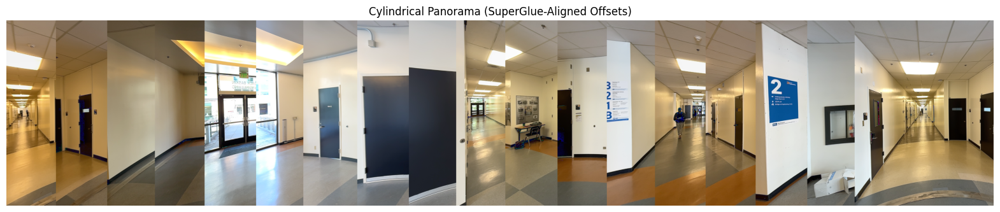

In [12]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")
max_images = 20

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

# === CYLINDRICAL WARP FUNCTION ===
def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]
    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]
    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)
    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]
    return cv.remap(img, x_map.astype(np.float32), y_map.astype(np.float32), interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)

# === SORT IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === INIT ===
warped_images = []
offsets = [0]

for i in range(min(len(sorted_images) - 1, max_images - 1)):
    img1_name = sorted_images[i]
    img2_name = sorted_images[i + 1]
    path1 = os.path.join(image_dir, img1_name)
    path2 = os.path.join(image_dir, img2_name)
    im1 = cv.imread(path1)
    im2 = cv.imread(path2)
    if im1 is None or im2 is None:
        continue

    # Warp both
    warp1 = cylindrical_warp(im1, K)
    warp2 = cylindrical_warp(im2, K)
    if i == 0:
        warped_images.append(warp1)

    # Load SuperGlue matches
    base1 = img1_name.replace(".png", "")
    base2 = img2_name.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")
    if not os.path.exists(npz_path):
        print(f"❌ Missing match file: {npz_path}")
        continue

    data = np.load(npz_path)
    matches = data['matches']
    kp0 = data['keypoints0']
    kp1 = data['keypoints1']

    valid = matches > -1
    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]

    if len(pts0) < 4:
        print(f"⚠️ Too few valid matches: {img1_name} ↔ {img2_name}")
        continue

    # Estimate x-offset between warped images
    dx_vals = pts0[:, 0] - pts1[:, 0]
    dx = int(np.median(dx_vals))

    print(f"📐 SuperGlue Δx between {img1_name} → {img2_name}: {dx} px")
    offsets.append(offsets[-1] + dx)
    warped_images.append(warp2)

# === BUILD PANORAMA ===
max_height = max(img.shape[0] for img in warped_images)
total_width = offsets[-1] + warped_images[-1].shape[1]
canvas = np.zeros((max_height, total_width, 3), dtype=np.uint8)

for img, x in zip(warped_images, offsets):
    h, w = img.shape[:2]
    canvas[0:h, x:x + w] = np.where(img > 0, img, canvas[0:h, x:x + w])

# === VISUALIZE ===
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(canvas, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (SuperGlue-Aligned Offsets)")
plt.axis('off')
plt.show()


✅ image_0031858.png ↔ image_0031857.png, dx = 514
✅ image_0031857.png ↔ image_0031856.png, dx = 531
✅ image_0031856.png ↔ image_0031855.png, dx = 494
✅ image_0031855.png ↔ image_0031853.png, dx = 515
✅ image_0031853.png ↔ image_0031852.png, dx = 534
✅ image_0031852.png ↔ image_0031851.png, dx = 489
✅ image_0031851.png ↔ image_0031849.png, dx = 559
✅ image_0031849.png ↔ image_0031848.png, dx = 535
✅ image_0031848.png ↔ image_0031846.png, dx = 490
✅ image_0031846.png ↔ image_0031845.png, dx = 509
✅ image_0031845.png ↔ image_0031843.png, dx = 541
✅ image_0031843.png ↔ image_0031842.png, dx = 511
✅ image_0031842.png ↔ image_0031840.png, dx = 499
✅ image_0031840.png ↔ image_0031838.png, dx = 525
✅ image_0031838.png ↔ image_0031836.png, dx = 518
✅ image_0031836.png ↔ image_0031834.png, dx = 535
✅ image_0031834.png ↔ image_0031831.png, dx = 491


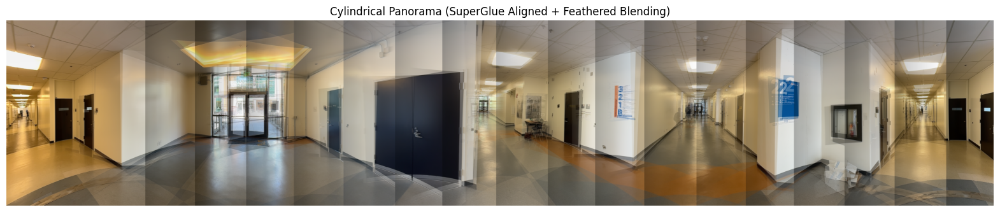

In [ ]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")
max_images = 20

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

# === CYLINDRICAL WARP FUNCTION ===
def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]
    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]
    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)
    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]
    return cv.remap(img, x_map.astype(np.float32), y_map.astype(np.float32),
                    interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)

# === ESTIMATE ΔX USING SUPERGLUE MATCHES ===
def estimate_dx_from_superglue(npz_path):
    if not os.path.exists(npz_path):
        return None
    data = np.load(npz_path)
    matches = data["matches"]
    kp0 = data["keypoints0"]
    kp1 = data["keypoints1"]
    valid = matches > -1
    if np.sum(valid) < 4:
        return None
    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    dx_vals = pts0[:, 0] - pts1[:, 0]
    return int(np.median(dx_vals))

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === WARP & ALIGN ===
warped_images = []
offsets = [0]

for i in range(min(len(sorted_images) - 1, max_images - 1)):
    img1 = sorted_images[i]
    img2 = sorted_images[i + 1]
    img1_path = os.path.join(image_dir, img1)
    img2_path = os.path.join(image_dir, img2)
    im1 = cv.imread(img1_path)
    im2 = cv.imread(img2_path)
    if im1 is None or im2 is None:
        continue

    warp1 = cylindrical_warp(im1, K)
    warp2 = cylindrical_warp(im2, K)
    if i == 0:
        warped_images.append(warp1)

    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")
    dx = estimate_dx_from_superglue(npz_path)
    if dx is None:
        dx = warp1.shape[1] // 2  # fallback if no match found

    offsets.append(offsets[-1] + dx)
    warped_images.append(warp2)
    print(f"✅ {img1} ↔ {img2}, dx = {dx}")

# === CANVAS INIT ===
max_height = max(img.shape[0] for img in warped_images)
total_width = offsets[-1] + warped_images[-1].shape[1]
canvas = np.zeros((max_height, total_width, 3), dtype=np.float32)

# === FEATHERED BLENDING ===
for i, (img, x) in enumerate(zip(warped_images, offsets)):
    h, w = img.shape[:2]
    subcanvas = canvas[0:h, x:x + w]

    if i > 0:
        alpha = np.linspace(0, 1, w).reshape(1, w, 1)
        blended = img * alpha + subcanvas * (1 - alpha)
    else:
        blended = img

    canvas[0:h, x:x + w] = blended

# === VISUALIZE ===
canvas_uint8 = np.clip(canvas, 0, 255).astype(np.uint8)
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(canvas_uint8, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (SuperGlue Aligned + Feathered Blending)")
plt.axis('off')
plt.show()


✅ image_0031858.png ↔ image_0031857.png, dx = 514
✅ image_0031857.png ↔ image_0031856.png, dx = 531
✅ image_0031856.png ↔ image_0031855.png, dx = 494
✅ image_0031855.png ↔ image_0031853.png, dx = 515
✅ image_0031853.png ↔ image_0031852.png, dx = 534
✅ image_0031852.png ↔ image_0031851.png, dx = 489
✅ image_0031851.png ↔ image_0031849.png, dx = 559
✅ image_0031849.png ↔ image_0031848.png, dx = 535
✅ image_0031848.png ↔ image_0031846.png, dx = 490
✅ image_0031846.png ↔ image_0031845.png, dx = 509
✅ image_0031845.png ↔ image_0031843.png, dx = 541
✅ image_0031843.png ↔ image_0031842.png, dx = 511
✅ image_0031842.png ↔ image_0031840.png, dx = 499
✅ image_0031840.png ↔ image_0031838.png, dx = 525
✅ image_0031838.png ↔ image_0031836.png, dx = 518
✅ image_0031836.png ↔ image_0031834.png, dx = 535
✅ image_0031834.png ↔ image_0031831.png, dx = 491


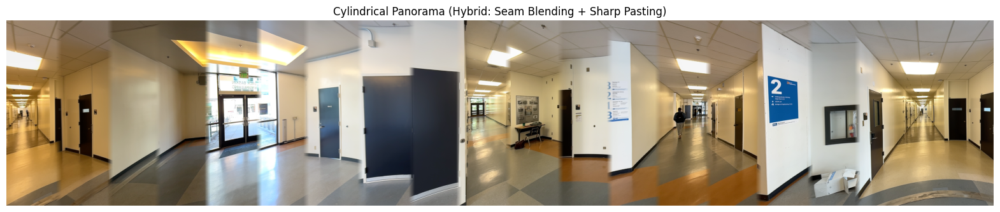

In [12]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")
max_images = 20
blend_width = 60  # width of the seam blend zone

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]
    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]
    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)
    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]
    return cv.remap(img, x_map.astype(np.float32), y_map.astype(np.float32),
                    interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)

def estimate_dx_from_superglue(npz_path):
    if not os.path.exists(npz_path):
        return None
    data = np.load(npz_path)
    matches = data["matches"]
    kp0 = data["keypoints0"]
    kp1 = data["keypoints1"]
    valid = matches > -1
    if np.sum(valid) < 4:
        return None
    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    dx_vals = pts0[:, 0] - pts1[:, 0]
    return int(np.median(dx_vals))

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === WARP & ALIGN ===
warped_images = []
offsets = [0]

for i in range(min(len(sorted_images) - 1, max_images - 1)):
    img1 = sorted_images[i]
    img2 = sorted_images[i + 1]
    im1 = cv.imread(os.path.join(image_dir, img1))
    im2 = cv.imread(os.path.join(image_dir, img2))
    if im1 is None or im2 is None:
        continue

    warp1 = cylindrical_warp(im1, K)
    warp2 = cylindrical_warp(im2, K)
    if i == 0:
        warped_images.append(warp1)

    npz_path = os.path.join(output_dir, f"{img1.replace('.png', '')}_{img2.replace('.png', '')}_matches.npz")
    dx = estimate_dx_from_superglue(npz_path)
    if dx is None:
        dx = warp1.shape[1] // 2

    offsets.append(offsets[-1] + dx)
    warped_images.append(warp2)
    print(f"✅ {img1} ↔ {img2}, dx = {dx}")

# === CANVAS BUILD ===
max_height = max(img.shape[0] for img in warped_images)
total_width = offsets[-1] + warped_images[-1].shape[1]
canvas = np.zeros((max_height, total_width, 3), dtype=np.uint8)

for i, (img, x) in enumerate(zip(warped_images, offsets)):
    h, w = img.shape[:2]

    if i == 0:
        canvas[0:h, x:x + w] = img
        continue

    # Blend the seam region
    blend_start = x
    blend_end = x + blend_width
    left = canvas[0:h, blend_start:blend_end].astype(np.float32)
    right = img[:, :blend_width].astype(np.float32)

    alpha = np.linspace(0, 1, blend_width).reshape(1, blend_width, 1)
    blended = (right * alpha + left * (1 - alpha)).astype(np.uint8)
    canvas[0:h, blend_start:blend_end] = blended

    # Paste the rest of the new image sharply
    canvas[0:h, blend_end:x + w] = img[:, blend_width:]

# === DISPLAY ===
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(canvas, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (Hybrid: Seam Blending + Sharp Pasting)")
plt.axis('off')
plt.show()


✅ image_0031858.png ↔ image_0031857.png, dx = 514
✅ image_0031857.png ↔ image_0031856.png, dx = 531
✅ image_0031856.png ↔ image_0031855.png, dx = 494
✅ image_0031855.png ↔ image_0031853.png, dx = 515
✅ image_0031853.png ↔ image_0031852.png, dx = 534
✅ image_0031852.png ↔ image_0031851.png, dx = 489
✅ image_0031851.png ↔ image_0031849.png, dx = 559
✅ image_0031849.png ↔ image_0031848.png, dx = 535
✅ image_0031848.png ↔ image_0031846.png, dx = 490
✅ image_0031846.png ↔ image_0031845.png, dx = 509
✅ image_0031845.png ↔ image_0031843.png, dx = 541
✅ image_0031843.png ↔ image_0031842.png, dx = 511
✅ image_0031842.png ↔ image_0031840.png, dx = 499
✅ image_0031840.png ↔ image_0031838.png, dx = 525
✅ image_0031838.png ↔ image_0031836.png, dx = 518
✅ image_0031836.png ↔ image_0031834.png, dx = 535
✅ image_0031834.png ↔ image_0031831.png, dx = 491


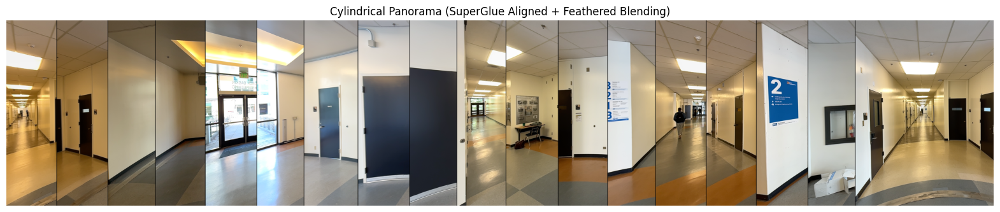

In [19]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
base_dir = "../Panorama/BE/Session_1744229291"
image_dir = base_dir
output_dir = os.path.join(base_dir, "outputSG")
max_images = 20

# === CAMERA INTRINSICS ===
K = np.array([
    [1329.477, 0, 967.92554],
    [0, 1329.477, 718.25934],
    [0, 0, 1]
])

# === CYLINDRICAL WARP FUNCTION ===
def cylindrical_warp(img, K):
    h, w = img.shape[:2]
    f = K[0, 0]
    y_i, x_i = np.indices((h, w))
    x = x_i - K[0, 2]
    y = y_i - K[1, 2]
    theta = np.arctan(x / f)
    h_ = y / np.sqrt(x**2 + f**2)
    x_map = f * theta + K[0, 2]
    y_map = f * h_ + K[1, 2]
    return cv.remap(img, x_map.astype(np.float32), y_map.astype(np.float32),
                    interpolation=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)

# === ESTIMATE ΔX USING SUPERGLUE MATCHES ===
def estimate_dx_from_superglue(npz_path):
    if not os.path.exists(npz_path):
        return None
    data = np.load(npz_path)
    matches = data["matches"]
    kp0 = data["keypoints0"]
    kp1 = data["keypoints1"]
    valid = matches > -1
    if np.sum(valid) < 4:
        return None
    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    dx_vals = pts0[:, 0] - pts1[:, 0]
    return int(np.median(dx_vals))

# === SORTED IMAGES ===
sorted_images = sorted(
    [f for f in os.listdir(image_dir) if f.startswith("image_") and f.endswith(".png")],
    key=lambda x: int(x.split("_")[1].split(".")[0]),
    reverse=True
)

# === WARP & ALIGN ===
warped_images = []
offsets = [0]

for i in range(min(len(sorted_images) - 1, max_images - 1)):
    img1 = sorted_images[i]
    img2 = sorted_images[i + 1]
    img1_path = os.path.join(image_dir, img1)
    img2_path = os.path.join(image_dir, img2)
    im1 = cv.imread(img1_path)
    im2 = cv.imread(img2_path)
    if im1 is None or im2 is None:
        continue

    warp1 = cylindrical_warp(im1, K)
    warp2 = cylindrical_warp(im2, K)
    if i == 0:
        warped_images.append(warp1)

    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")
    dx = estimate_dx_from_superglue(npz_path)
    if dx is None:
        dx = warp1.shape[1] // 2  # fallback if no match found

    offsets.append(offsets[-1] + dx)
    warped_images.append(warp2)
    print(f"✅ {img1} ↔ {img2}, dx = {dx}")

# === CANVAS INIT ===
max_height = max(img.shape[0] for img in warped_images)
total_width = offsets[-1] + warped_images[-1].shape[1]
canvas = np.zeros((max_height, total_width, 3), dtype=np.float32)

# === FEATHERED BLENDING ===
def compute_homography(npz_path):
    if not os.path.exists(npz_path):
        return None
    data = np.load(npz_path)
    matches = data["matches"]
    kp0 = data["keypoints0"]
    kp1 = data["keypoints1"]
    valid = matches > -1
    if np.sum(valid) < 4:
        return None
    pts0 = kp0[valid]
    pts1 = kp1[matches[valid]]
    H, _ = cv.findHomography(pts1, pts0, cv.RANSAC)
    return H

# Blend with homographies at seams only
blend_width = 10

for i, (img, x) in enumerate(zip(warped_images, offsets)):
    h, w = img.shape[:2]

    if i == 0:
        canvas[0:h, x:x + w] = img
        continue

    # Get SuperGlue match homography
    img1 = sorted_images[i - 1]
    img2 = sorted_images[i]
    base1 = img1.replace(".png", "")
    base2 = img2.replace(".png", "")
    npz_path = os.path.join(output_dir, f"{base1}_{base2}_matches.npz")
    H = compute_homography(npz_path)

    # Apply homography to the full warped image (cylindrical already done)
    if H is not None:
        warped_full = cv.warpPerspective(img, H, (w, h))
    else:
        warped_full = img  # fallback

    # Extract seam region from the warped image
    seam_w = min(blend_width, w)
    warped_seam = warped_full[:, :seam_w]
    canvas_seam = canvas[0:h, x:x + seam_w]

    # Blend only the seam
    alpha = np.linspace(0, 1, seam_w).reshape(1, seam_w, 1)
    blended = warped_seam * alpha + canvas_seam * (1 - alpha)
    canvas[0:h, x:x + seam_w] = blended

    # Paste the rest of the original image (unwarped)
    canvas[0:h, x + seam_w:x + w] = img[:, seam_w:]

# === VISUALIZE ===
canvas_uint8 = np.clip(canvas, 0, 255).astype(np.uint8)
plt.figure(figsize=(20, 10))
plt.imshow(cv.cvtColor(canvas_uint8, cv.COLOR_BGR2RGB))
plt.title("Cylindrical Panorama (SuperGlue Aligned + Feathered Blending)")
plt.axis('off')
plt.show()
